In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
os.chdir('../')

In [3]:
import numpy as np
import torch
import torch.nn.functional as F

In [4]:
from sklearn import metrics
from sklearn.metrics.pairwise import cosine_similarity

In [5]:
import pickle
import pandas as pd
import numpy as np
from tqdm import tqdm
from modules.evaluation import compute_accuracy_with_bootstrapping
from scipy.ndimage.filters import gaussian_filter1d
import modules
from modules import tensorboard_utils, matplotlib_utils, utils, losses, data_utils
from modules.tensorboard_utils import plot_from_tensorboard
from modules import result_utils

In [12]:
%matplotlib notebook
import matplotlib
from matplotlib import pyplot as plt
import seaborn
matplotlib_utils.set_default_configs(plt, seaborn)
from mpl_toolkits.axes_grid1 import make_axes_locatable

In [13]:
matplotlib.rcParams['pdf.fonttype'] = 42

# Process db

In [8]:
list_of_datasets = [
    'results/hpc_results.pkl',
    'results/aaron_results.pkl'
]
all_results = result_utils.load_result_tables(list_of_datasets)
result_utils.fill_short_names(all_results)
agg_results = result_utils.get_agg_results(all_results)
best_results = result_utils.do_model_selection_by_val_score(agg_results)
df = best_results  # shortcut

In [16]:
df[(df.method_name == 'Predict-Laplace') & (df.data_augmentation == 1.0) & (df.dataset == 'cifar10') &
   (df.label_noise_type == 'error') & (df.label_noise_level	== 0.2)].grad_weight_decay

87    1.0
Name: grad_weight_decay, dtype: float64

# look at the results

In [10]:
def print_results_per_dataset(df):
    # skip some cases
    if df.dataset.iloc[0] == 'cifar10' and df.data_augmentation.iloc[0] == 0.0:
        return
    data_columns = result_utils.data_columns
    data_values = df[data_columns].iloc[0]
    data_params_dict = dict(zip(data_columns, data_values))
    print(data_params_dict)
    for idx, row in df.iterrows():
        print("{:<30} {:.3f} {:.3f}".format(row['method_name'], 100*row['test_accuracy_mean'], 100*row['test_accuracy_std']))
    print("\n\n")
    return df.iloc[0]  # dummy

df.groupby(result_utils.data_columns).apply(print_results_per_dataset);

{'dataset': 'cifar10', 'label_noise_level': 0.0, 'label_noise_type': 'cifar10_custom', 'num_train_examples': 'N/A', 'remove_prob': 0.5, 'transform_function': 'N/A', 'data_augmentation': 1.0}
Predict-Gaussian               93.510 nan
Predict-Gaussian-loaded        93.320 nan
Predict-Laplace                93.120 nan
Predict-Laplace-loaded         93.310 nan
CE                             92.654 0.368
DMI                            93.020 nan
FW                             92.890 nan
MAE                            84.366 5.208



{'dataset': 'cifar10', 'label_noise_level': 0.1, 'label_noise_type': 'cifar10_custom', 'num_train_examples': 'N/A', 'remove_prob': 0.5, 'transform_function': 'N/A', 'data_augmentation': 1.0}
Predict-Gaussian               92.760 nan
Predict-Gaussian-loaded        93.260 nan
Predict-Laplace                91.855 0.007
Predict-Laplace-loaded         92.980 nan
CE                             89.984 0.563
DMI                            91.420 nan
FW                 

In [13]:
def bootstrap(test_predictions_file, verbose=True):
    with open(test_predictions_file, 'rb') as f:
        saved_data = pickle.load(f)
    
    preds = saved_data['pred'].numpy()
    labels = saved_data['labels'].numpy()
    
    results = compute_accuracy_with_bootstrapping(preds, labels)
    if verbose:
        print("{:.2f} {:.2f}".format(100*results['mean'], 100*results['std']))
    return results


def extract_results(df, all_results, dataset, noise_levels=None, num_train_examples=None, methods=None,
                    label_noise_type='flip', results_dir='hpc_logs', bootstrap_std=False, print_stds=False,
                    verbose=False):

    # filter dataset
    df = df[df.dataset == dataset]
    df = df[df.label_noise_type == label_noise_type]

    if noise_levels is None:
        noise_levels = list(set(df.label_noise_level))
        noise_levels = sorted(noise_levels)
    
    if num_train_examples is None:
        num_train_examples = list(set(df.num_train_examples))
        num_train_examples = sorted(num_train_examples, key=lambda x: 2**30 if x=='N/A' else int(x))

    if methods is None:
        methods = list(set(df.method_name))
    
    methods = sorted(methods, key=lambda x: result_utils.method_order[x])

    n_methods = len(methods)
    n_noises = len(noise_levels)
    n_samples = len(num_train_examples)
    
    means = np.zeros((n_methods, n_noises, n_samples), dtype=np.float)
    stds = np.zeros_like(means)
    
    for method_idx, method in enumerate(methods):
        for noise_idx, noise_level in enumerate(noise_levels):
            for sample_cnt_idx, sample_cnt in enumerate(num_train_examples):
                part = df[(df.method_name == method) & (df.label_noise_level == noise_level) & (df.num_train_examples == sample_cnt)]
                if len(part) == 0:
                    continue
                assert len(part) == 1
                part = part.iloc[0]
                
                # find the log_dir
                log_dir = None
                for idx, row in all_results.iterrows():
                    if row.seed != 42:
                        continue
                    found = True
                    for k, val in part.items():
                        if k in row and row[k] != val:
                            found = False
                            break
                    if found:
                        log_dir = row.log_dir
                        break
                assert log_dir is not None
                dir_name = os.path.basename(log_dir)
                if verbose:
                    print(dir_name)
                
                # get mean and std
                means[method_idx, noise_idx, sample_cnt_idx] = part.test_accuracy_mean
                stds[method_idx, noise_idx, sample_cnt_idx] = part.test_accuracy_std
                
                if bootstrap_std:  # bootstapping on the tets set to get error bars
                    bootstrap_results = bootstrap(f'{results_dir}/{dir_name}/test_predictions.pkl', verbose=False)
                    stds[method_idx, noise_idx, sample_cnt_idx] = bootstrap_results['std']

    for method_idx, method in enumerate(methods):
        print("{:<30}".format(method), end='')
        for noise_idx, noise_level in enumerate(noise_levels):
            for sample_cnt_idx, sample_cnt in enumerate(num_train_examples):
                if noise_level == 0.99 and sample_cnt == 100:
                    continue
                if print_stds:
                    print(" & {:4.1f} $\pm$ {:4.1f}".format(100*means[method_idx, noise_idx, sample_cnt_idx],
                                                            100*stds[method_idx, noise_idx, sample_cnt_idx]), end='')
                else:
                    print(" & {:4.1f}".format(100*means[method_idx, noise_idx, sample_cnt_idx]), end='')

        print("\\\\")

In [18]:
# MNIST
extract_results(df, all_results, dataset='mnist', label_noise_type='error', print_stds=True,
                noise_levels=[0.8, 0.89], num_train_examples=[1000, 10000, 'N/A'])

CE                             & 27.0 $\pm$  3.8 & 69.9 $\pm$  2.6 & 87.2 $\pm$  1.0 & 10.3 $\pm$  1.6 & 13.4 $\pm$  3.3 & 13.2 $\pm$  1.8\\
CE-noisy-grad-Gaussian         & 25.9 $\pm$  4.6 & 51.9 $\pm$ 10.5 & 85.3 $\pm$  8.3 & 10.4 $\pm$  4.5 & 10.2 $\pm$  3.3 & 11.1 $\pm$  0.4\\
CE-noisy-grad-Laplace          & 30.2 $\pm$  4.8 & 53.1 $\pm$  6.4 & 74.5 $\pm$ 19.1 & 11.9 $\pm$  3.9 &  8.8 $\pm$  5.4 & 14.1 $\pm$  4.3\\
MAE                            & 25.1 $\pm$  3.3 & 74.6 $\pm$  2.7 & 93.2 $\pm$  1.1 & 10.9 $\pm$  1.4 & 12.1 $\pm$  3.9 & 17.6 $\pm$  8.1\\
FW                             & 19.0 $\pm$  4.1 & 61.2 $\pm$  5.0 & 89.1 $\pm$  2.1 &  8.7 $\pm$  2.8 & 11.4 $\pm$  1.4 & 12.3 $\pm$  1.8\\
DMI                            & 30.3 $\pm$  5.1 & 79.0 $\pm$  1.5 & 88.8 $\pm$  0.9 & 10.5 $\pm$  1.2 & 14.1 $\pm$  5.1 & 12.5 $\pm$  1.5\\
Penalize                       & 28.8 $\pm$  2.2 & 67.0 $\pm$  1.9 & 89.3 $\pm$  0.6 & 10.3 $\pm$  1.6 & 10.5 $\pm$  0.8 & 12.7 $\pm$  2.6\\
Predict-Gauss

In [18]:
# CIFAR-10 custom
extract_results(df[df.data_augmentation == 1.0], all_results, dataset='cifar10', label_noise_type='cifar10_custom',
                noise_levels=[0.0, 0.1, 0.2, 0.3, 0.4], num_train_examples=['N/A'],
                bootstrap_std=True, print_stds=True)

bootstrapping: 100%|██████████| 1000/1000 [00:00<00:00, 1430.00it/s]


CE                             & 92.7 $\pm$  0.3 & 90.0 $\pm$  0.3 & 88.1 $\pm$  0.3 & 87.2 $\pm$  0.3 & 81.8 $\pm$  0.4\\
MAE                            & 84.4 $\pm$  0.4 & 88.6 $\pm$  0.3 & 83.2 $\pm$  0.4 & 72.1 $\pm$  0.4 & 61.1 $\pm$  0.5\\
FW                             & 92.9 $\pm$  0.3 & 90.1 $\pm$  0.3 & 88.0 $\pm$  0.3 & 86.8 $\pm$  0.3 & 84.6 $\pm$  0.3\\
DMI                            & 93.0 $\pm$  0.3 & 91.4 $\pm$  0.3 & 90.6 $\pm$  0.3 & 90.4 $\pm$  0.3 & 89.6 $\pm$  0.3\\
Predict-Gaussian               & 93.5 $\pm$  0.2 & 92.8 $\pm$  0.3 & 91.3 $\pm$  0.3 & 89.2 $\pm$  0.3 & 86.0 $\pm$  0.3\\
Predict-Laplace                & 93.1 $\pm$  0.3 & 91.9 $\pm$  0.3 & 91.1 $\pm$  0.3 & 88.8 $\pm$  0.3 & 84.2 $\pm$  0.4\\
Predict-Gaussian-loaded        & 93.3 $\pm$  0.2 & 93.3 $\pm$  0.3 & 92.9 $\pm$  0.3 & 90.8 $\pm$  0.3 & 88.3 $\pm$  0.3\\
Predict-Laplace-loaded         & 93.3 $\pm$  0.2 & 93.0 $\pm$  0.3 & 92.3 $\pm$  0.3 & 91.1 $\pm$  0.3 & 90.0 $\pm$  0.3\\


In [19]:
# CIFAR-10 error
extract_results(df[df.data_augmentation == 1.0], all_results, dataset='cifar10', label_noise_type='error',
                noise_levels=[0.2, 0.4, 0.6, 0.8], num_train_examples=['N/A'],
                bootstrap_std=True, print_stds=True)

bootstrapping: 100%|██████████| 1000/1000 [00:00<00:00, 1427.80it/s]

CE                             & 85.2 $\pm$  0.4 & 81.0 $\pm$  0.4 & 69.0 $\pm$  0.5 & 38.8 $\pm$  0.5\\
MAE                            & 85.4 $\pm$  0.4 & 64.6 $\pm$  0.5 & 15.4 $\pm$  0.4 & 12.0 $\pm$  0.3\\
FW                             & 86.2 $\pm$  0.3 & 81.4 $\pm$  0.4 & 69.7 $\pm$  0.5 & 34.4 $\pm$  0.5\\
DMI                            & 88.3 $\pm$  0.3 & 85.0 $\pm$  0.3 & 72.5 $\pm$  0.4 & 38.9 $\pm$  0.5\\
Predict-Gaussian               & 90.7 $\pm$  0.3 & 86.6 $\pm$  0.3 & 73.7 $\pm$  0.4 & 38.7 $\pm$  0.5\\
Predict-Laplace                & 91.5 $\pm$  0.3 & 88.2 $\pm$  0.3 & 75.7 $\pm$  0.4 & 35.8 $\pm$  0.5\\
Predict-Gaussian-loaded        & 92.4 $\pm$  0.3 & 90.3 $\pm$  0.3 & 81.9 $\pm$  0.4 & 44.1 $\pm$  0.5\\
Predict-Laplace-loaded         & 92.2 $\pm$  0.3 & 90.2 $\pm$  0.3 & 82.9 $\pm$  0.4 & 44.3 $\pm$  0.5\\


In [15]:
# CIFAR-100
extract_results(df, all_results, dataset='cifar100', label_noise_type='error', bootstrap_std=True, print_stds=True,
                results_dir='aaron_logs', verbose=True)

bootstrapping:   4%|▍         | 42/1000 [00:00<00:02, 412.31it/s]

cifar100-error-noise0.4-StandardClassifier-augment-seed42


bootstrapping:   4%|▎         | 35/1000 [00:00<00:02, 348.26it/s]

cifar100-error-noise0.4-StandardClassifier-mae-augment-seed42


bootstrapping:   3%|▎         | 28/1000 [00:00<00:03, 276.93it/s]

cifar100-error-noise0.4-StandardClassifier-fw-augment-seed42


bootstrapping:   3%|▎         | 28/1000 [00:00<00:03, 276.66it/s]

cifar100-error-noise0.4-StandardClassifier-dmi-lr1e-05-augment-seed42


bootstrapping:   2%|▏         | 23/1000 [00:00<00:04, 225.29it/s]

cifar100-error-noise0.4-PredictGradOutput-Gaussian-L10.0-augment-seed42


bootstrapping:   4%|▍         | 41/1000 [00:00<00:02, 404.43it/s]

cifar100-error-noise0.4-PredictGradOutput-Laplace-L1.0-augment-seed42


bootstrapping:   3%|▎         | 29/1000 [00:00<00:03, 288.17it/s]

cifar100-error-noise0.4-PredictGradOutput-Gaussian-L30.0-augment-loaded-seed42


bootstrapping:   0%|          | 0/1000 [00:00<?, ?it/s]

cifar100-error-noise0.4-PredictGradOutput-Laplace-L3.0-augment-loaded-seed42


bootstrapping: 100%|██████████| 1000/1000 [00:02<00:00, 405.93it/s]

CE                             & 44.9 $\pm$  0.5\\
MAE                            &  1.8 $\pm$  0.1\\
FW                             & 23.3 $\pm$  0.4\\
DMI                            & 46.1 $\pm$  0.5\\
Predict-Gaussian               & 58.4 $\pm$  0.5\\
Predict-Laplace                & 49.5 $\pm$  0.5\\
Predict-Gaussian-loaded        & 59.2 $\pm$  0.5\\
Predict-Laplace-loaded         & 60.8 $\pm$  0.5\\


# Training curves

In [16]:
best_files = [
    {
        'name': 'CE',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-seed42',
        'marker': 's',
        'markevery': (20, 40)
    },
    {
        'name': 'CE + GN',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-noisygrad-Gaussian-std0.01-seed42',
        'marker': 'v',
        'markevery': (30, 40)
    },
    {
        'name': 'CE + LN',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-noisygrad-Laplace-std0.01-seed42',
    },
    {
        'name': 'MAE',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-mae-seed42',
        'marker': '|',
        'markevery': 40,
    },
    {
        'name': 'FW',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-fw-seed42',
        'marker': 'X',
        'markevery': 40
    },
    {
        'name': 'DMI',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-dmi-lr1e-05-seed42',
        'marker': 'p',
        'markevery': (10, 40)
    },
    {
        'name': 'Soft reg. (8)',
        'dir_path': 'mnist-error-noise0.8-PenalizeLastLayerFixedForm-lamb0.001-L1.0-seed42',
        'marker': 'P',
        'markevery': 40,
    },
    {
        'name': 'LIMIT$_\\mathcal{G}$ + S',
        'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Gaussian-lamb5000.0-L30.0-sample-seed42',
        'marker': '*',
        'markevery': (10, 40),
    },
    {
        'name': 'LIMIT$_\\mathcal{L}$ + S',
        'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Laplace-lamb100-L10.0-sample-seed42',
        'marker': 'd',
        'markevery': 40
    },
    {    'name': 'LIMIT$_\\mathcal{G}$ - S',
        'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Gaussian-L100.0-seed42',
        'marker': 'x',
        'markevery': (30, 40),
    },
    {
        'name': 'LIMIT$_\\mathcal{L}$ - S',
        'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Laplace-L10.0-seed42',
        'marker': 'o',
        'markevery': (20, 40),
    }
]

<IPython.core.display.Javascript object>


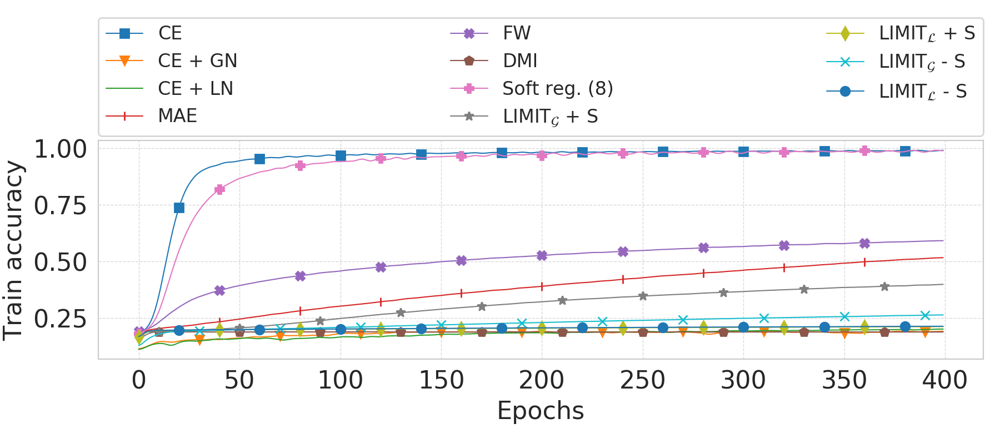

<IPython.core.display.Javascript object>


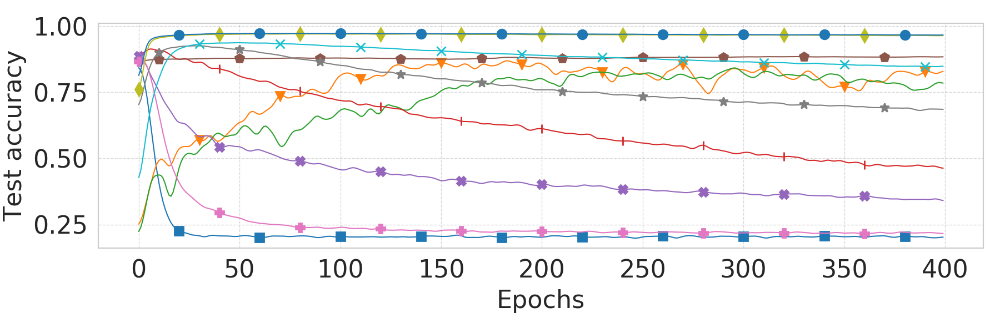

In [17]:
plot_from_tensorboard(plt, best_files, common_prefix='clean_val_logs', tag='metrics/train_accuracy', smoothing=True,
                      ylabel='Train accuracy', figsize=(9,4), savename='plots/mnist-error-noise80-train.pdf',
                      linewidth=0.75,
                      legend_args={
                         'bbox_to_anchor': (0.0, 1.02, 1, 0.04),
                         'loc': 'lower left',
                         'ncol': (len(best_files)+3)//4,
                         'borderaxespad': 0,
                         'fancybox': True,
                         'mode': 'expand'});
plot_from_tensorboard(plt, best_files, common_prefix='clean_val_logs', tag='metrics/val_accuracy', smoothing=True,
                      linewidth=0.75, ylabel='Test accuracy', figsize=(9,3),
                      savename='plots/mnist-error-noise80-test.pdf',);

### Effects of $\beta$ and $\lambda$

In [22]:
def effect_of_regulariaztion_plot(df, name):
    markers = ['o', 's', 'd', 'x', '*', 'v', 'X', 'p', '|']
    files = []
    cur_idx = 0
    for (idx, row) in df.iterrows():
        d = dict()
        d['name'] = f'$\\beta$ = {row.grad_weight_decay}'
        d['dir_path'] = os.path.basename(row.log_dir)
        d['marker'] = markers[cur_idx]
        d['markevery'] = (10 * (cur_idx % 4), 40)
        files.append(d)
        cur_idx = (cur_idx + 1) % len(markers)
        
    plot_from_tensorboard(plt, files, common_prefix='clean_val_logs', tag='metrics/train_accuracy', smoothing=True,
                          ylabel='Train accuracy', figsize=(9,4), savename=f'plots/mnist-error-noise80-{name}-train.pdf',
                          linewidth=0.75,
                          legend_args={
                             'bbox_to_anchor': (0.0, 1.02, 1, 0.04),
                             'loc': 'lower left',
                             'ncol': (len(best_files)+3)//4,
                             'borderaxespad': 0,
                             'fancybox': True,
                             'mode': 'expand'});
    plot_from_tensorboard(plt, files, common_prefix='clean_val_logs', tag='metrics/val_accuracy', smoothing=True, linewidth=0.75,
                          ylabel='Test accuracy', figsize=(9,3), savename=f'plots/mnist-error-noise80-{name}-test.pdf');

<IPython.core.display.Javascript object>


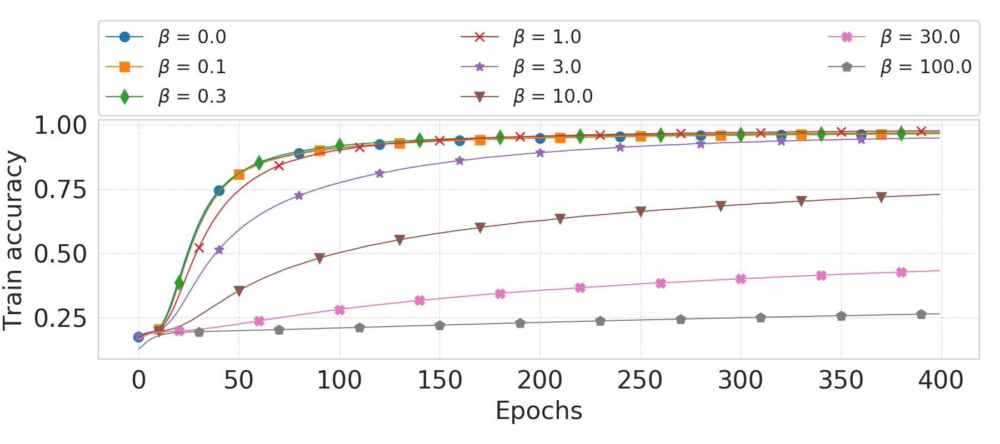

<IPython.core.display.Javascript object>


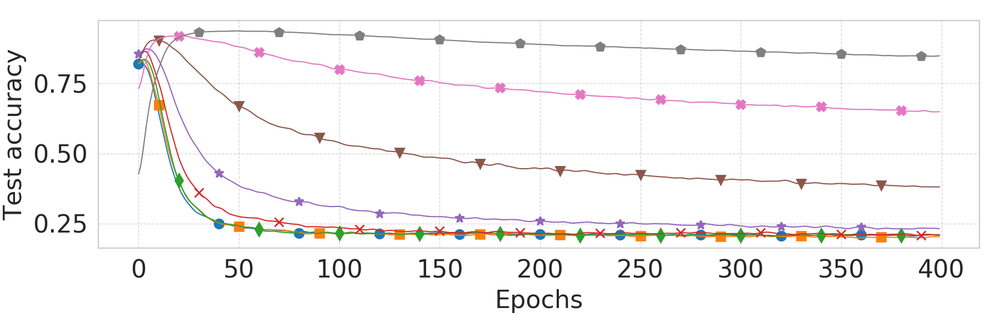

<IPython.core.display.Javascript object>


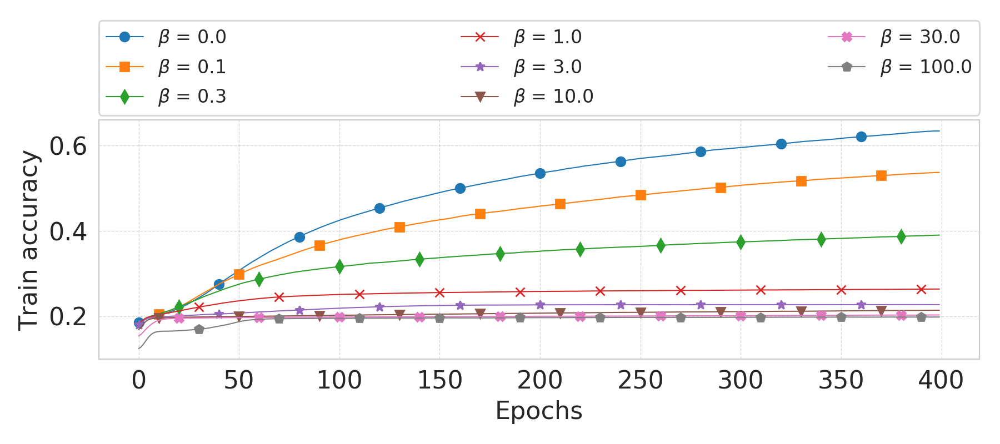

<IPython.core.display.Javascript object>


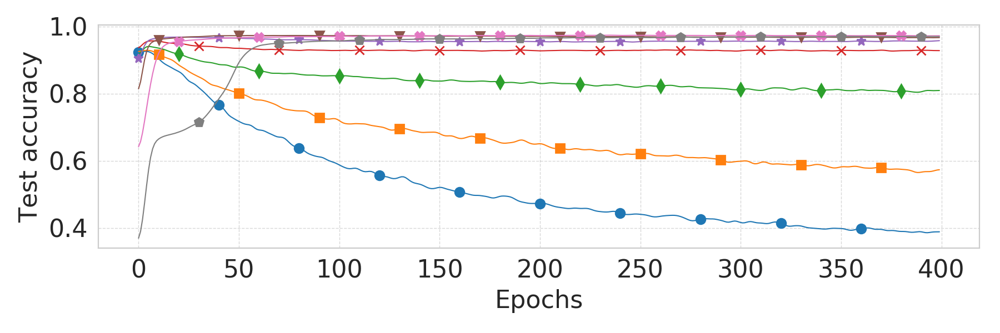

In [23]:
gaussian_df = all_results[(all_results.dataset == 'mnist') & (all_results.label_noise_type == 'error') &
            (all_results.label_noise_level == 0.8) & (all_results.model_class == 'PredictGradOutput') &
            (all_results.sample_from_q == False) & (all_results.num_train_examples == 'N/A') & 
            (all_results.seed == 42) & (all_results.q_dist == 'Gaussian')]
gaussian_df = gaussian_df.sort_values(by='grad_weight_decay')
effect_of_regulariaztion_plot(gaussian_df, 'gaussian')


# Laplace
laplace_df = all_results[(all_results.dataset == 'mnist') & (all_results.label_noise_type == 'error') &
            (all_results.label_noise_level == 0.8) & (all_results.model_class == 'PredictGradOutput') &
            (all_results.sample_from_q == False) & (all_results.num_train_examples == 'N/A') & 
            (all_results.seed == 42) & (all_results.q_dist == 'Laplace')]
laplace_df = laplace_df.sort_values(by='grad_weight_decay')
effect_of_regulariaztion_plot(laplace_df, 'laplace')

# Detecting wrong samples & finding confusing samples

In [112]:
def get_image(x):
    """ Takes (1, H, W) or (3, H, W) and outputs (H, W, 3) """
    x = x.transpose((1, 2, 0))
    if x.shape[2] == 1:
        x = np.repeat(x, repeats=3, axis=2)
    return x

    samples = revert_normalization(samples, train_data)
    samples = utils.to_numpy(samples)

def plot_k_images_labeled(train_data, indices, q_label_pred, path, save=False, label_names=None):
    pad = 0.1
    img_size = 1.25
    k = len(indices)
    fig, ax = plt.subplots(nrows=1, ncols=k, figsize=((k-1)*pad + k*img_size, img_size+0.5))
    for i in range(len(indices)):
        idx = indices[i]
        img = train_data[idx][0]
        mnist = False
        if img.shape[-1] == 28:
            mnist = True
        img = data_utils.revert_normalization(img, train_data)[0]
        img = utils.to_numpy(img)
        img = get_image(img)
        
        import PIL
        from PIL import Image
        if mnist:   # MNIST, invert colors
            img = Image.fromarray(255-np.uint8(img*255))
        else:
            img = Image.fromarray(np.uint8(img*255))
        img = img.resize((224, 224))
#         img = img.resize((224, 224), resample=PIL.Image.BOX)
        ax[i].imshow(img)

        ax[i].set_axis_off()
        ax[i].set_xticklabels([])
        ax[i].set_yticklabels([])
        q_pred = q_label_pred[idx].argmax()
        if label_names is None:
            label_names = list(range(q_label_pred[0].shape[-1]))
        ax[i].set_title("{}".format(label_names[train_data[idx][1]]),
                        fontsize=(12 if train_data.dataset_name=='clothing1m' else 17),
                        y=(0.97 if mnist else 1.05))
#         ax[i].set_title("$y$ = {}\n$\\widehat{}$ = {}".format(label_names[train_data[idx][1]], '{y}', label_names[q_pred]),
#                 fontsize=14)
#     plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1.0)
    plt.tight_layout(w_pad=pad)
    if save:
        plt.savefig(path)

    
def examine_model(model_file, train_data, val_data, test_data, is_corrupted=None, device='cuda:0', prefix='',
                 save=False, label_names=None, num_workers=0, max_num_examples=2**30, save_data=False, image_cnt=8):
    model = utils.load(model_file, device=device, remove_load_from=True)
    ret = utils.apply_on_dataset(model, train_data, output_keys_regexp='pred|grad_pred|label|q_label_pred',
                                 num_workers=num_workers, max_num_examples=max_num_examples)
    grad_pred = ret['grad_pred']
    pred = torch.softmax(ret['pred'], dim=1)
    q_label_pred = torch.softmax(ret['q_label_pred'], dim=1)
    y = ret['label']
    num_classes = pred.shape[-1]
    y_one_hot = F.one_hot(y, num_classes=num_classes).float()
    
    if is_corrupted is not None:
        # grad_norm histogram
        grad_norms = torch.sum(grad_pred ** 2, dim=1)
        grad_norms = utils.to_numpy(grad_norms)

        plt.figure(figsize=(5,5))
        plt.hist(np.log(1e-20 + grad_norms[is_corrupted == 1]), bins=50, density=True, alpha=0.4, label='incorrect');
        plt.hist(np.log(1e-20 + grad_norms[is_corrupted == 0]), bins=50, density=True, alpha=0.4, label='correct');
        plt.xlabel('$\log || \mu ||_2^2$')
        plt.ylabel('Density')
        plt.legend();
        plt.tight_layout()
        if save:
            plt.savefig(f'plots/{prefix}corrupted_vs_clean_pred_grad_norm.pdf')

        # grad_diff histogram
        grad_actual = pred - y_one_hot
        grad_diff = torch.sum((grad_pred - grad_actual)**2, dim=1)
        grad_diff = utils.to_numpy(grad_diff)

        
        auc_score = metrics.roc_auc_score(y_true=(is_corrupted==1), y_score=grad_diff)
        print("AUC of detection:", auc_score)
        plt.figure(figsize=(5,5))
        plt.hist(grad_diff[is_corrupted == 1], bins=50, density=True, alpha=0.4, label='incorrect');
        plt.hist(grad_diff[is_corrupted == 0], bins=50, density=True, alpha=0.4, label='correct');
        plt.legend();
#         plt.xlabel('Norm of the difference of predicted and actual gradients')
        plt.xlabel('$||\mu - g^\mathcal{L}||_2^2$')
        plt.ylabel('Density')
        plt.title('ROC AUC score: {:.4f}'.format(auc_score), fontsize=15)
        plt.tight_layout()
        if save:
            plt.savefig(f'plots/{prefix}corrupted_vs_clean_pred_grad_diff.pdf')

        

        # confusing and obvious cases
        ## correct samples
        arr = list(filter(lambda idx: is_corrupted[idx] == 0, np.argsort(grad_diff)))
        plot_k_images_labeled(train_data, np.random.choice(arr[:100], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                             path=f'plots/{prefix}less-confusing-correct-samples.pdf')
        plot_k_images_labeled(train_data, np.random.choice(arr[-20:], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                             path=f'plots/{prefix}most-confusing-correct-samples.pdf')
        ## incorrect samples
        arr = list(filter(lambda idx: is_corrupted[idx] == 1, np.argsort(grad_diff)))
        plot_k_images_labeled(train_data, np.random.choice(arr[:50], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                         path=f'plots/{prefix}less-obvious-incorrect-samples.pdf')
        plot_k_images_labeled(train_data, np.random.choice(arr[-50:], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                         path=f'plots/{prefix}most-obvious-incorrect-samples.pdf')
    else:
        grad_actual = pred - y_one_hot
        grad_diff = torch.sum((grad_pred - grad_actual)**2, dim=1)
        grad_diff = utils.to_numpy(grad_diff)

        # confusing and obvious cases
        arr = list(np.argsort(grad_diff))
        plot_k_images_labeled(train_data, np.random.choice(arr[:100], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                             path=f'plots/{prefix}less-confusing-samples.pdf')
        plot_k_images_labeled(train_data, np.random.choice(arr[-20:], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                             path=f'plots/{prefix}most-confusing-samples.pdf')
        
        # confusing examples per class
        to_save = []
        for class_idx in range(num_classes):
            class_indices = [idx for idx in arr if y[idx] == class_idx]
            class_name = str(class_idx)
            if label_names is not None:
                class_name = label_names[class_idx]
            plot_k_images_labeled(train_data, np.random.choice(class_indices[-20:], image_cnt, replace=False), q_label_pred, save=save, label_names=label_names,
                                  path=f'plots/{prefix}{class_name}-most-confusing-samples.pdf')
            to_save.append({
                'class_idx': class_idx,
                'class_sorted_indices': class_indices,
                'class_name': class_name,
                'top100_q_label_pred': [q_label_pred[idx] for idx in class_indices[-100:]],
                'top100_pred': [pred[idx] for idx in class_indices[-100:]]
            })
        
        # most confusing one per class
        plot_k_images_labeled(train_data, [d['class_sorted_indices'][-1] for d in to_save], q_label_pred,
                              save=save, label_names=label_names,
                              path=f'plots/{prefix}most-confusing-one-per-class.pdf')
        return to_save

        # save data for later
#         if save_data == True:
#             with open(os.path.join('plots', 'resources', f'{prefix}most-confusing-samples.pkl'), 'wb') as f:
#                 pickle.dump(to_save, f)
        
    # transition matrix
    cf_matrix = np.zeros((num_classes, num_classes))
    
    for label in range(num_classes):
        indices = (y == label).numpy()
        cf_matrix[label, :] = q_label_pred[indices].mean(dim=0)
    
    fig, ax = plt.subplots(figsize=(5.35, 5))
    im = ax.imshow(cf_matrix, cmap='gray')
    ax.set_xticks(range(num_classes))
    ax.set_yticks(range(num_classes))
    if label_names is not None:
        ax.set_xticklabels(label_names, rotation=60)
        ax.set_yticklabels(label_names)

    divider = make_axes_locatable(ax)
    cax = divider.append_axes("right", size="6%", pad=0.1)
    fig.colorbar(im, cax=cax)
    ax.grid(False)
    plt.tight_layout()
    if save:
        plt.savefig(f'plots/{prefix}etimated_conf_matrix.pdf')

### MNIST error 80%

Loading the model from hpc_logs/mnist-error-noise0.8-PredictGradOutput-Laplace-L10.0-seed42/checkpoints/best_val.mdl
[None, 1, 28, 28]
[None, 32, 14, 14]
[None, 32, 7, 7]
[None, 64, 3, 3]
[None, 256, 1, 1]
[None, 256]
[None, 128]
output.shape: [None, 10]
[None, 1, 28, 28]
[None, 32, 14, 14]
[None, 32, 7, 7]
[None, 64, 3, 3]
[None, 256, 1, 1]
[None, 256]
[None, 128]
output.shape: [None, 10]


100%|██████████| 188/188 [00:07<00:00, 29.52it/s]


<IPython.core.display.Javascript object>


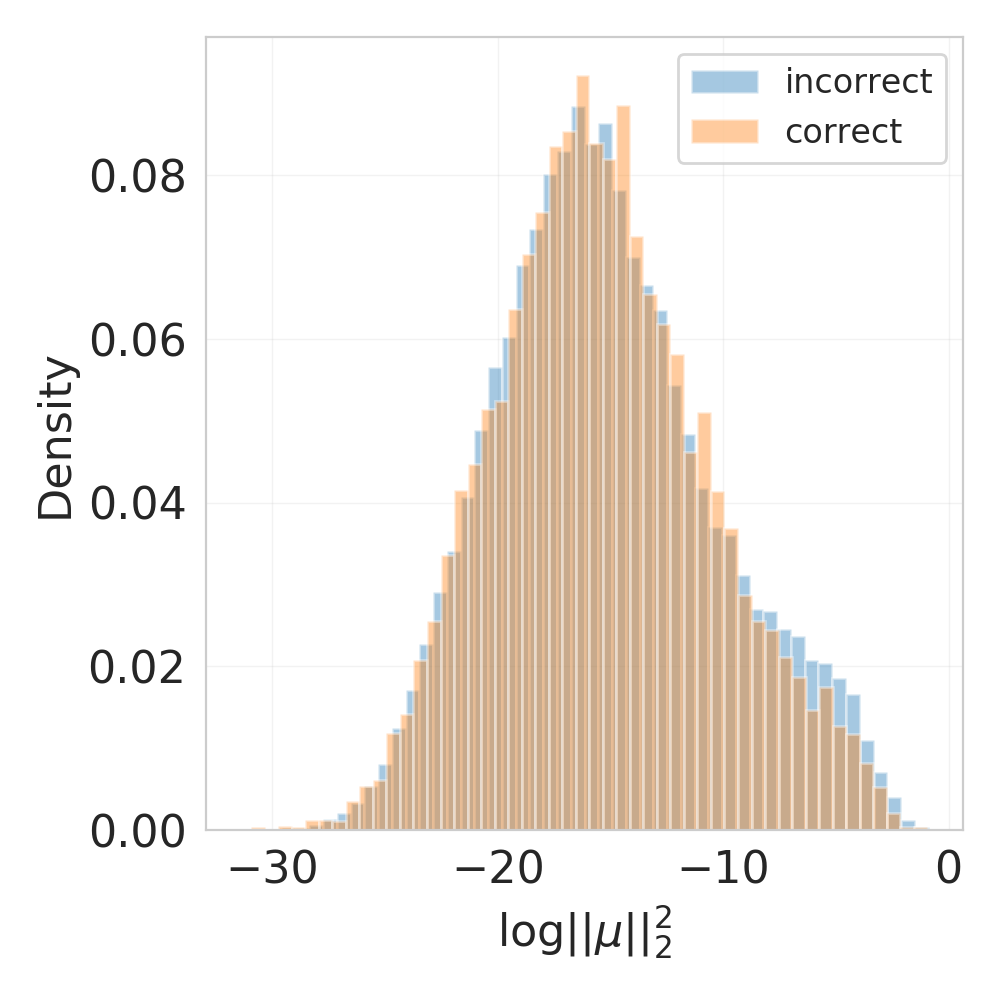

AUC of detection: 0.9987145762152713


/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


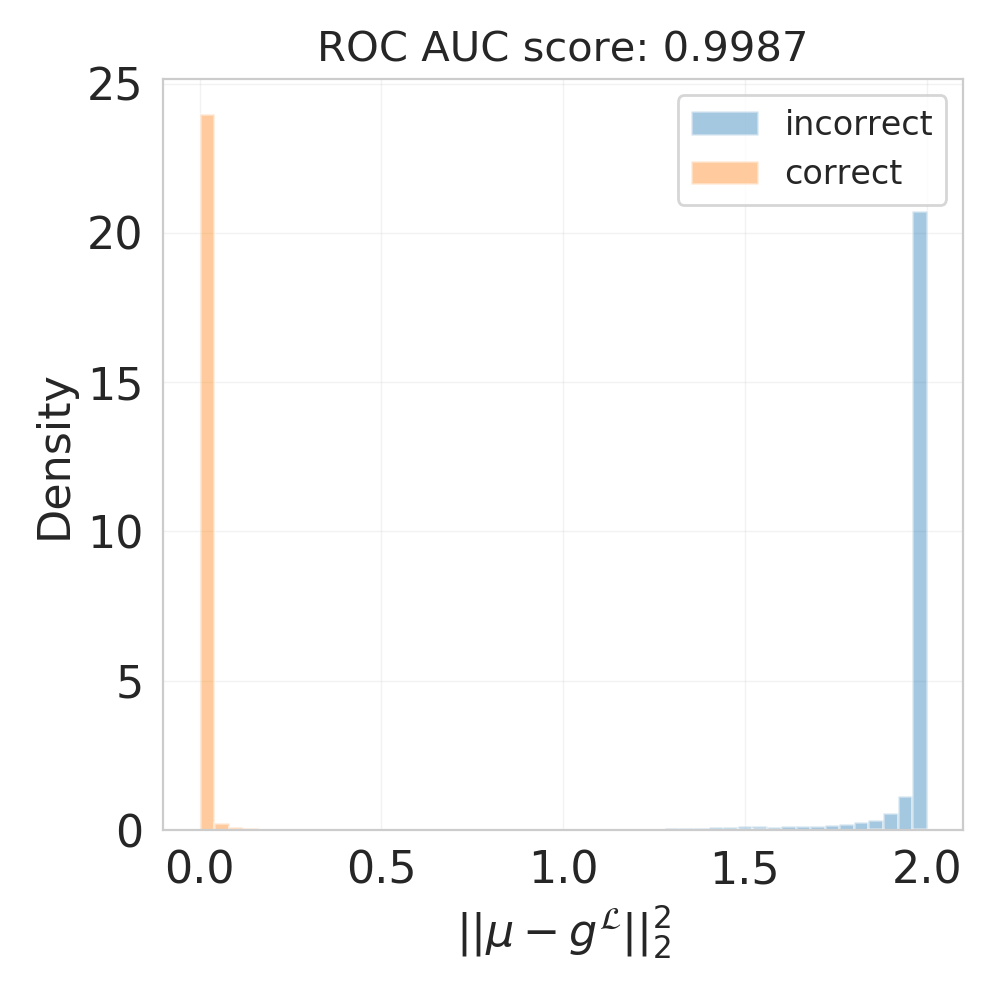

<IPython.core.display.Javascript object>


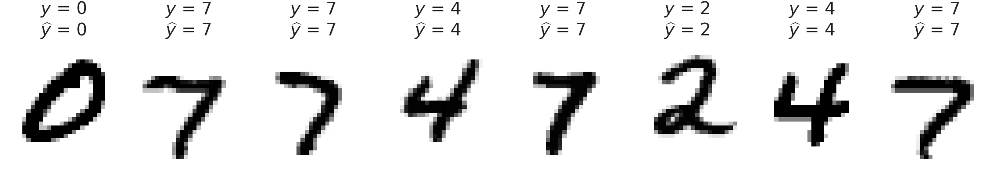

<IPython.core.display.Javascript object>


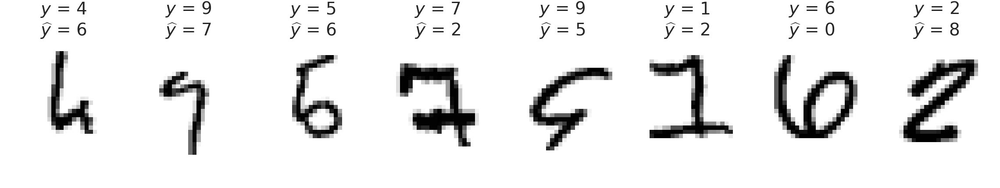

<IPython.core.display.Javascript object>


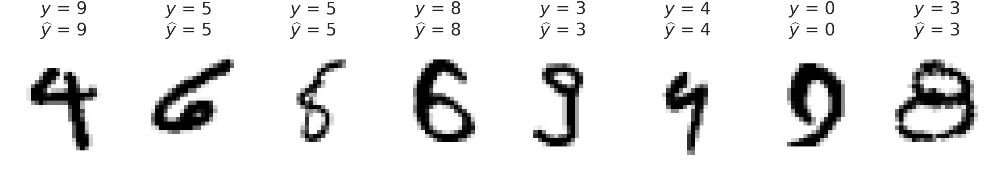

<IPython.core.display.Javascript object>


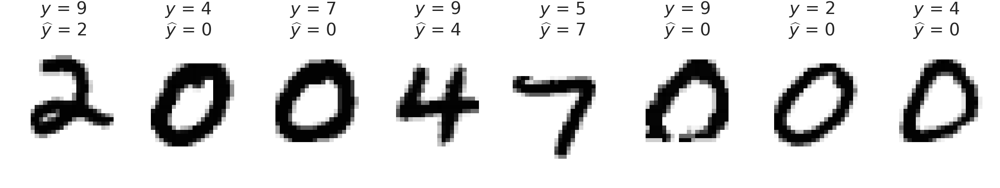

<IPython.core.display.Javascript object>


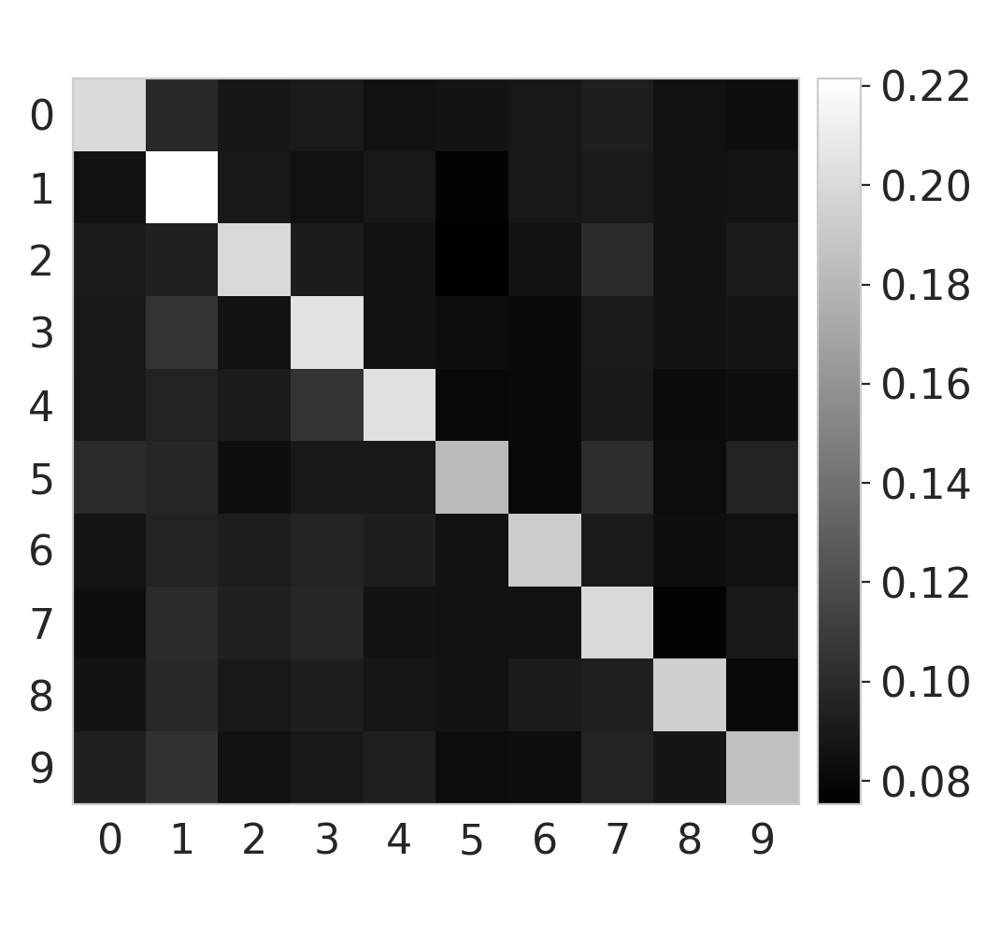

In [26]:
train_data, val_data, test_data, is_corrupted = data_utils.load_mnist_datasets(
    noise_level=0.8, confusion_function=data_utils.uniform_error_confusion_matrix, seed=42)
model_file = 'hpc_logs/mnist-error-noise0.8-PredictGradOutput-Laplace-L10.0-seed42/checkpoints/best_val.mdl'
examine_model(model_file, train_data, val_data, test_data, is_corrupted, device='cuda:0',
              prefix='mnist-error-noise80-', save=True, save_data=True)

### CIFAR-10 error-noise 40%

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Loading the model from hpc_logs/cifar10-error-noise0.4-augment-PredictGradOutput-Laplace-L1.0-seed42/checkpoints/best_val.mdl
output.shape: [None, 10]


  0%|          | 0/157 [00:00<?, ?it/s]

output.shape: [None, 10]


100%|██████████| 157/157 [00:26<00:00,  5.85it/s]


<IPython.core.display.Javascript object>


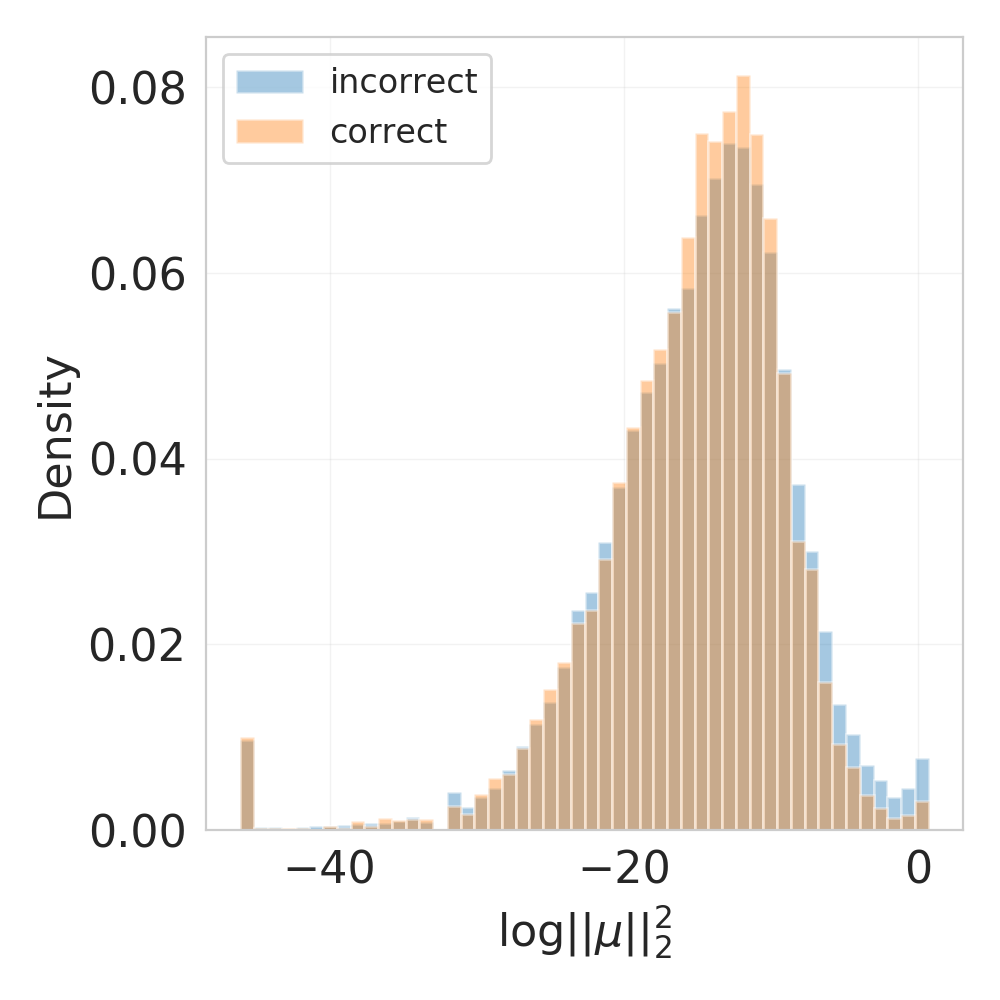

AUC of detection: 0.9912972457123066


/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


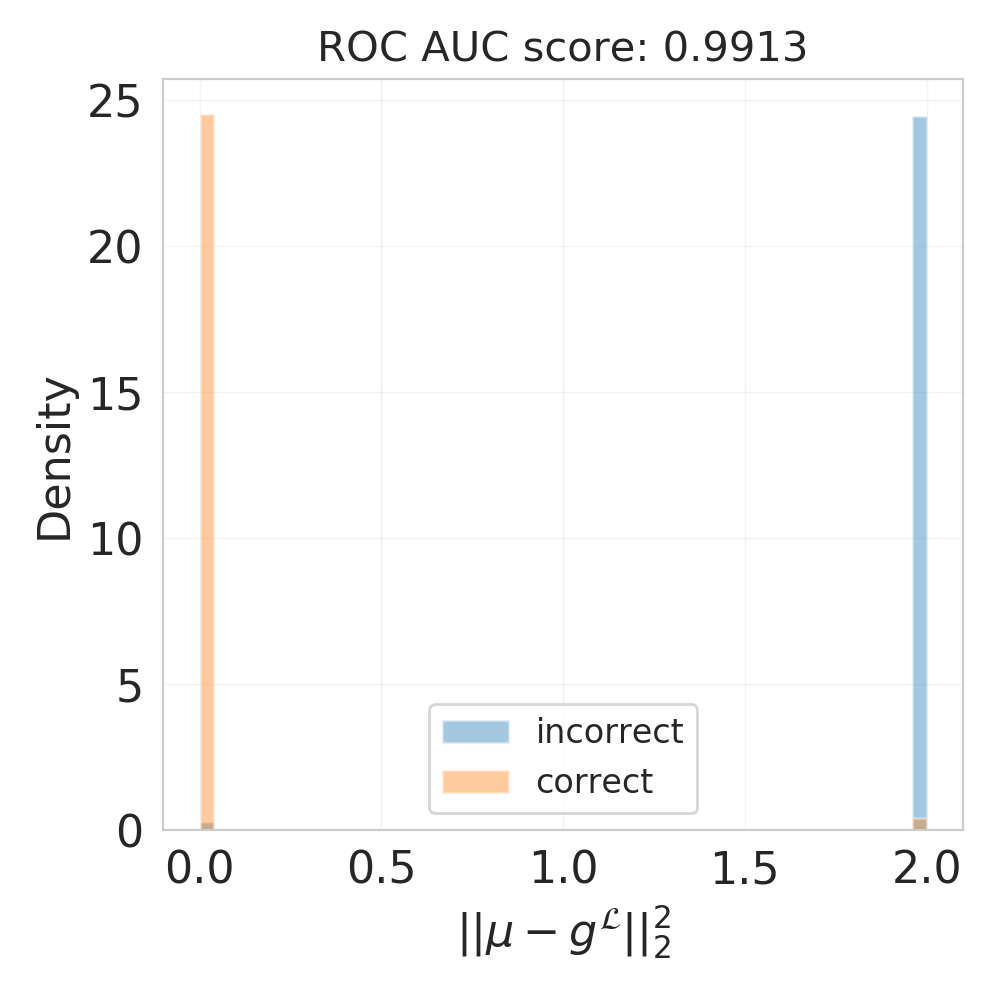

<IPython.core.display.Javascript object>


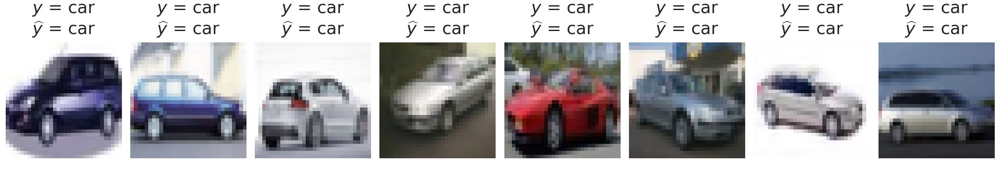

<IPython.core.display.Javascript object>


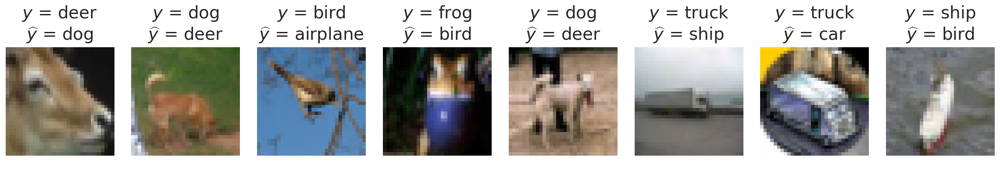

<IPython.core.display.Javascript object>


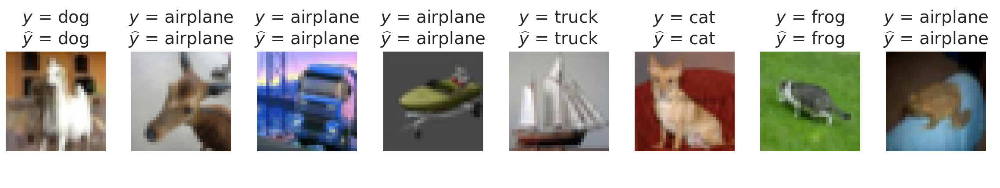

<IPython.core.display.Javascript object>


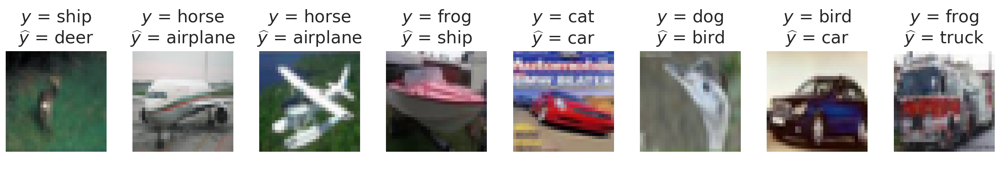

<IPython.core.display.Javascript object>


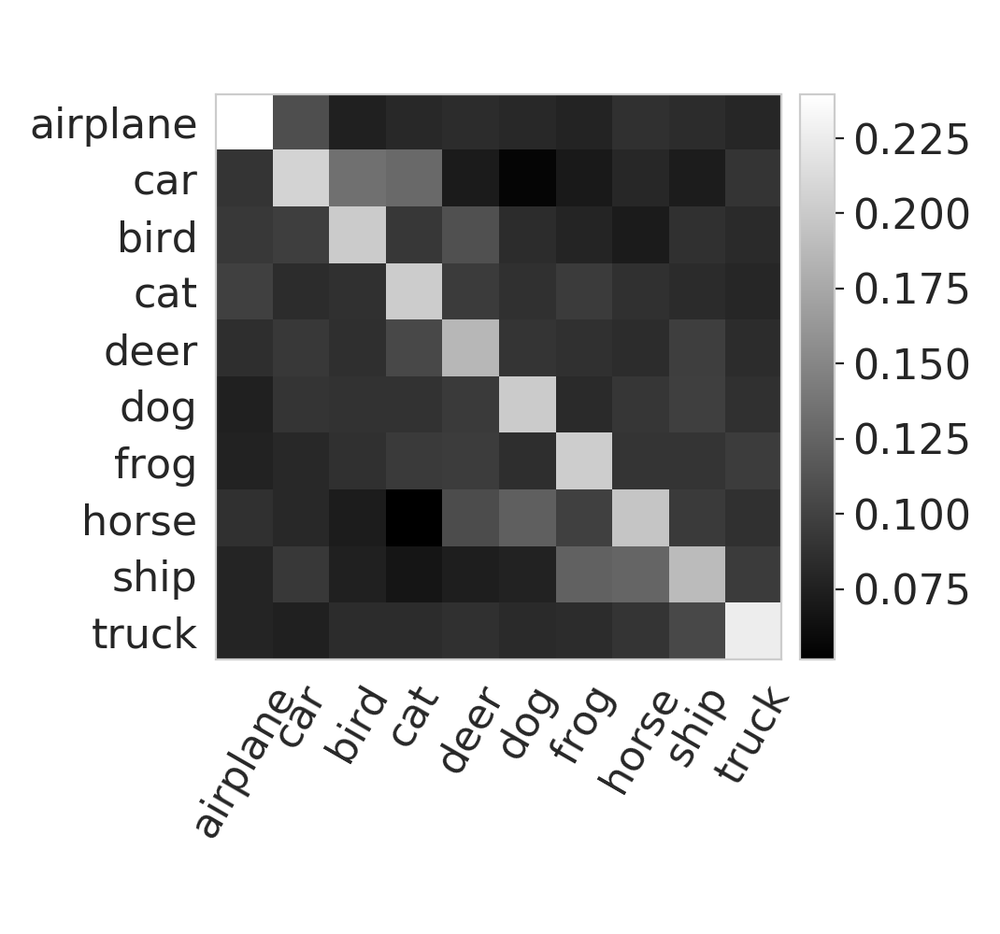

In [27]:
label_names = ['airplane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
train_data, val_data, test_data, is_corrupted = data_utils.load_cifar_datasets(
    noise_level=0.8, confusion_function=data_utils.uniform_error_confusion_matrix, seed=42)
model_file = 'hpc_logs/cifar10-error-noise0.4-augment-PredictGradOutput-Laplace-L1.0-seed42/checkpoints/best_val.mdl'
examine_model(model_file, train_data, val_data, test_data, is_corrupted, device='cuda:2',
              prefix='cifar10-error-noise40-', label_names=label_names, save=True)

### CIFAR-10 custom noise 40%

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Loading the model from hpc_logs/cifar10-custom-noise0.4-PredictGradOutput-Gaussian-L10.0-augment-seed42/checkpoints/best_val.mdl
output.shape: [None, 10]


  0%|          | 0/157 [00:00<?, ?it/s]

output.shape: [None, 10]


100%|██████████| 157/157 [00:27<00:00,  5.69it/s]


<IPython.core.display.Javascript object>


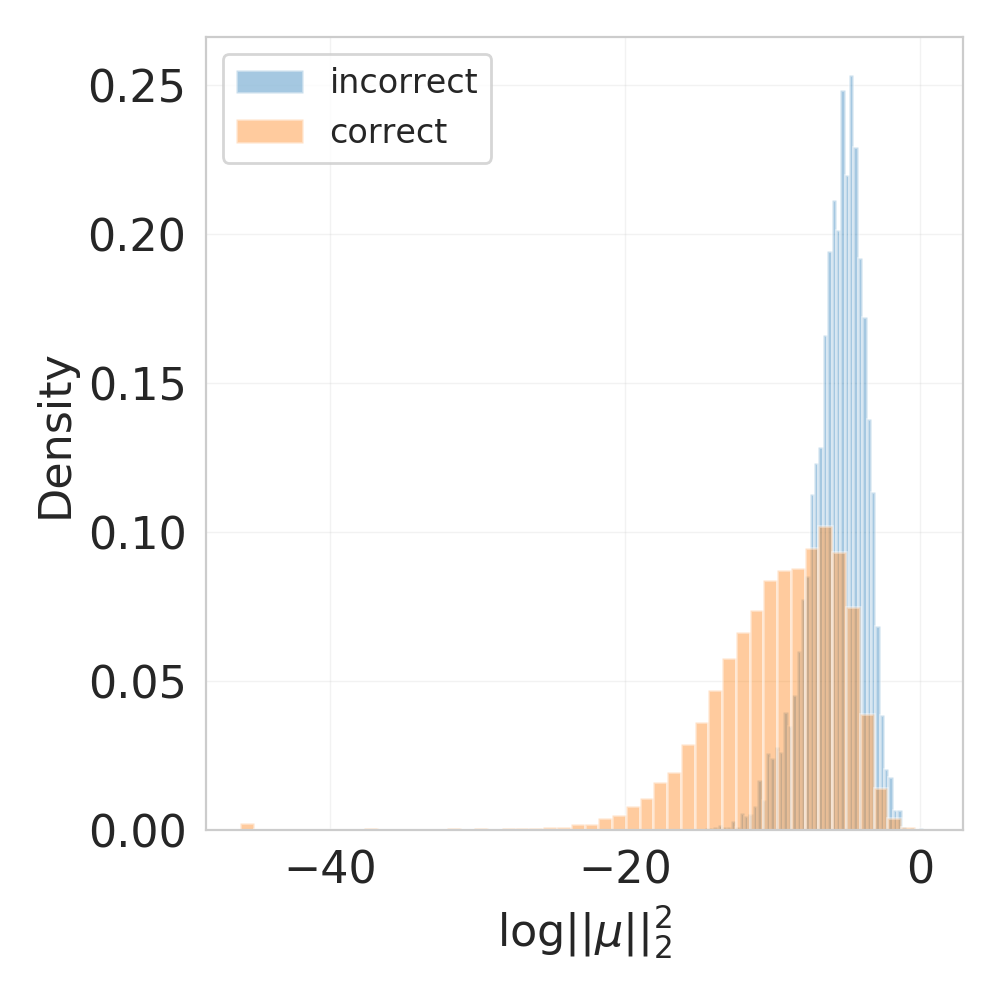

AUC of detection: 0.9109408179873512


/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


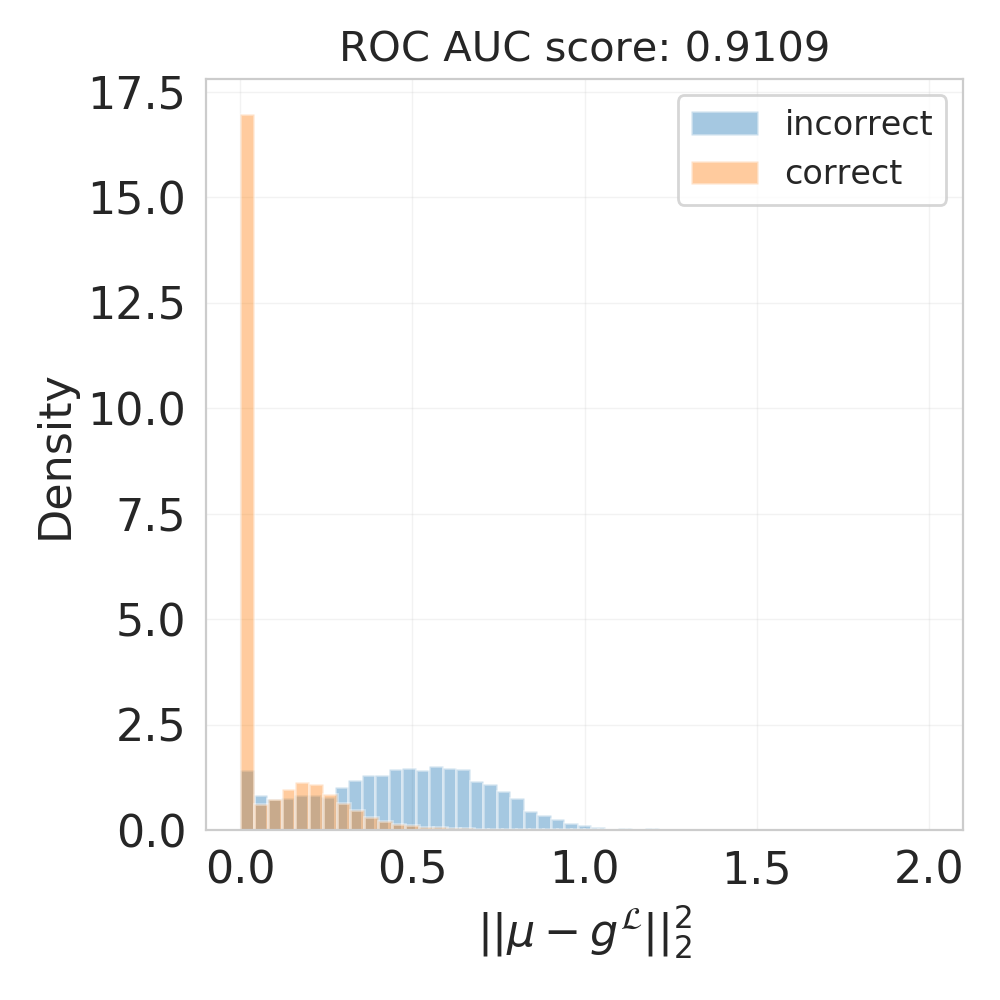

<IPython.core.display.Javascript object>


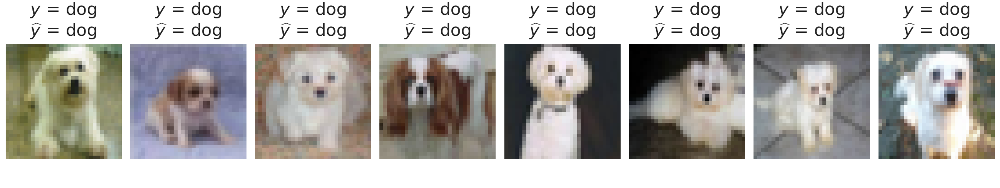

<IPython.core.display.Javascript object>


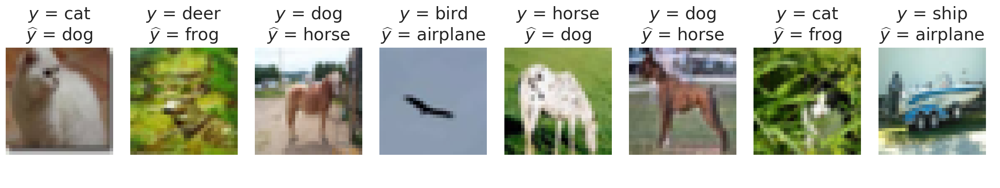

<IPython.core.display.Javascript object>


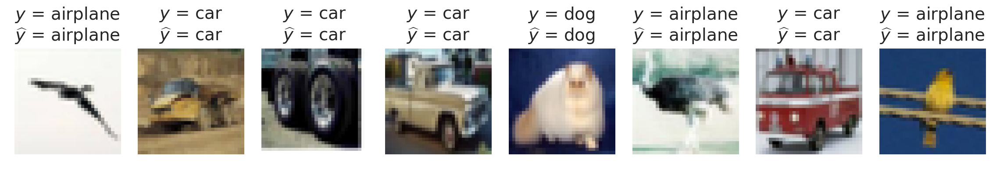

<IPython.core.display.Javascript object>


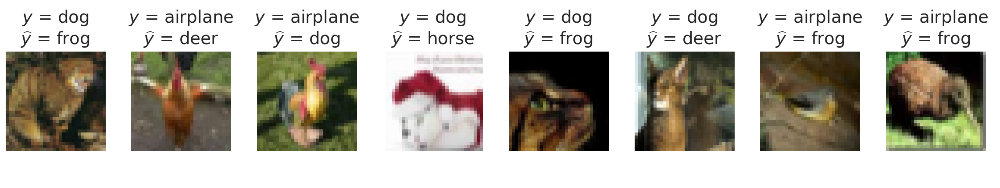

<IPython.core.display.Javascript object>


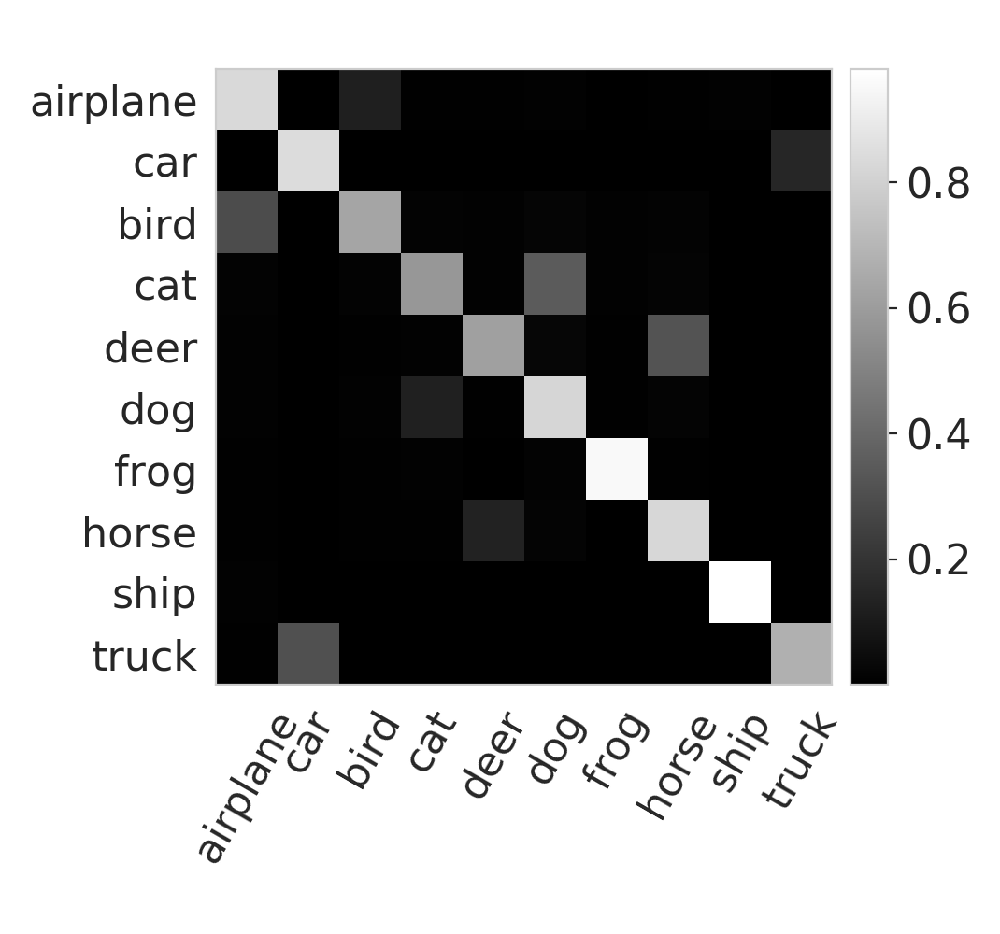

In [28]:
label_names = ['airplane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
train_data, val_data, test_data, is_corrupted = data_utils.load_cifar_datasets(
    noise_level=0.4, confusion_function=data_utils.cifar10_custom_confusion_matrix, seed=42)
model_file = 'hpc_logs/cifar10-custom-noise0.4-PredictGradOutput-Gaussian-L10.0-augment-seed42/checkpoints/best_val.mdl'
examine_model(model_file, train_data, val_data, test_data, is_corrupted, device='cuda:2',
              prefix='cifar10-custom-noise40-', label_names=label_names, save=True)

### CIFAR-100 40% uniform noise

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Loading the model from aaron_logs/cifar100-error-noise0.4-PredictGradOutput-Laplace-L3.0-augment-loaded-seed42/checkpoints/best_val.mdl
output.shape: [None, 100]


  0%|          | 0/157 [00:00<?, ?it/s]

output.shape: [None, 100]


100%|██████████| 157/157 [00:25<00:00,  6.14it/s]


<IPython.core.display.Javascript object>


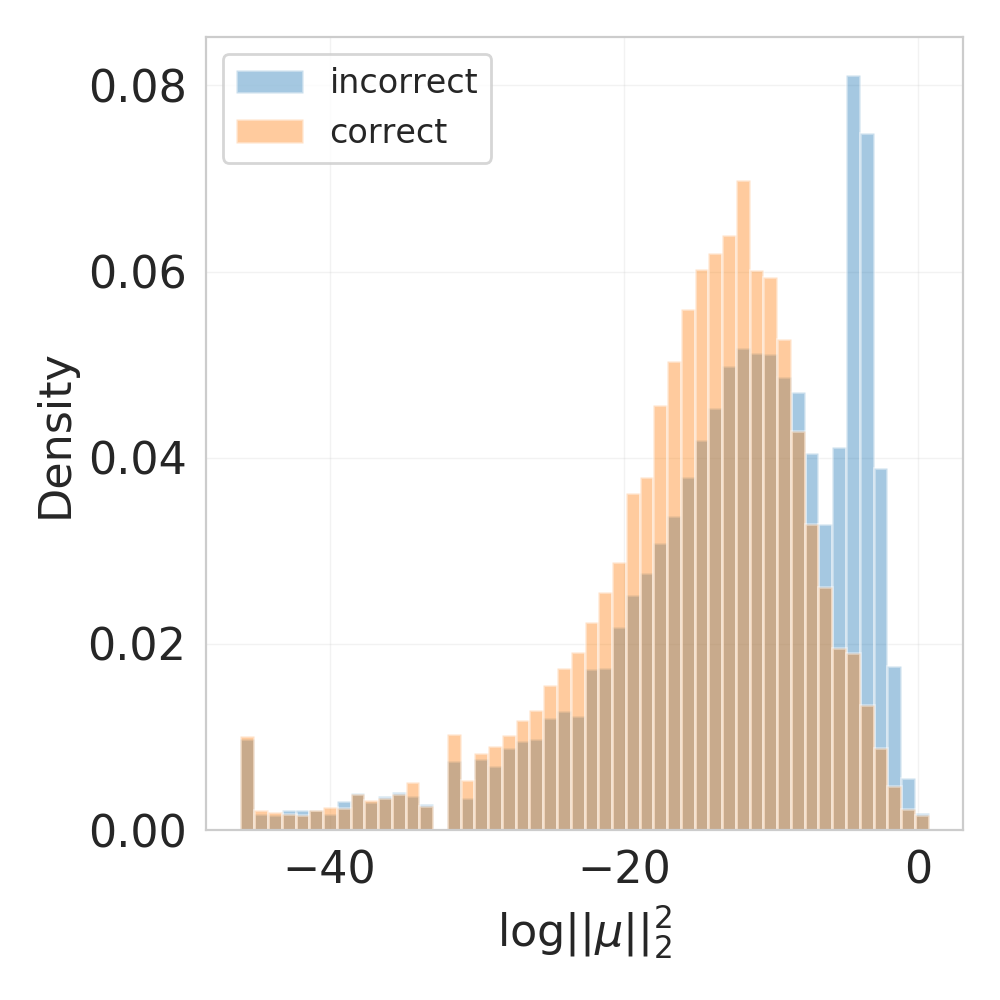

AUC of detection: 0.958533555308916


/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


<IPython.core.display.Javascript object>


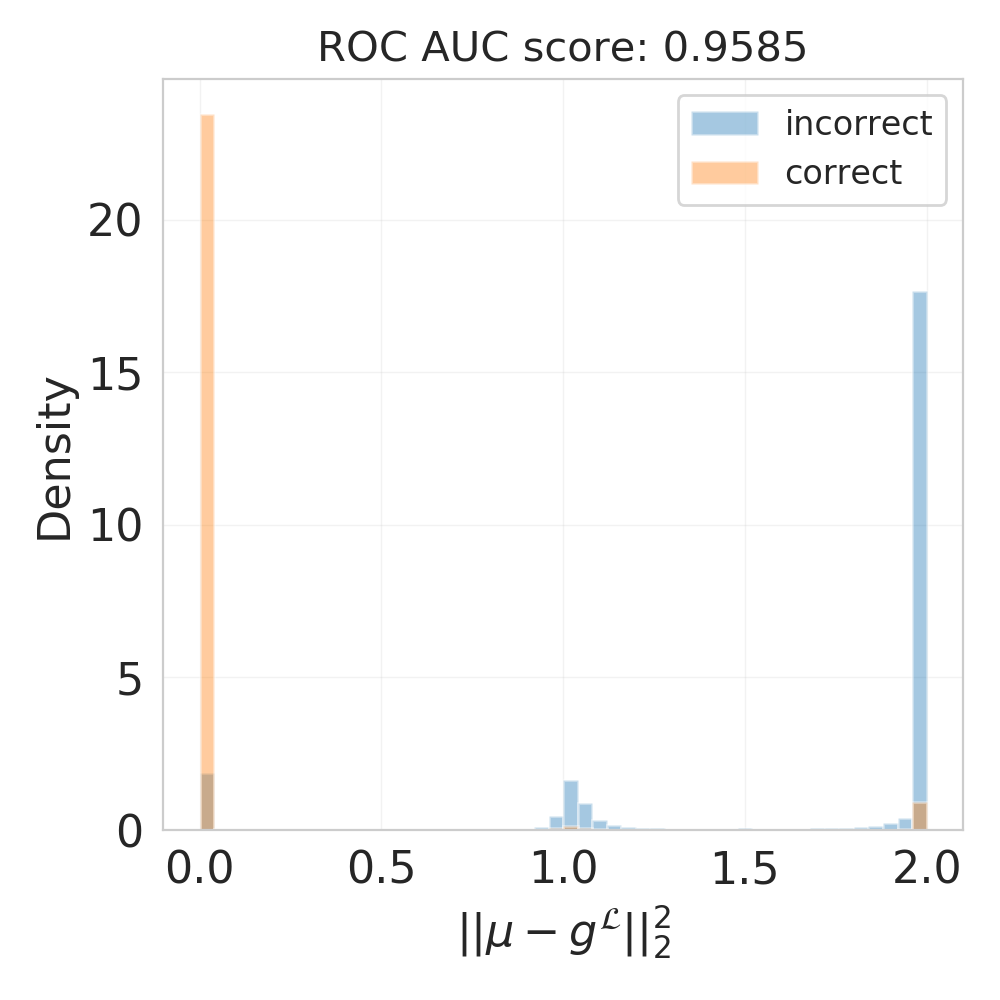

<IPython.core.display.Javascript object>


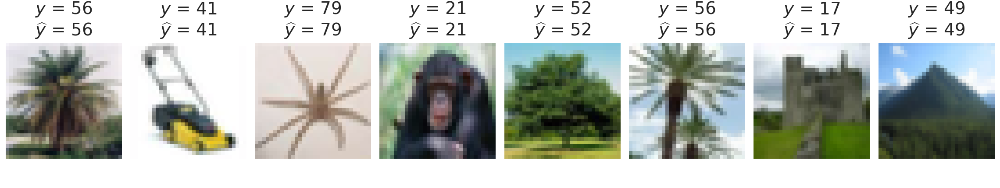

<IPython.core.display.Javascript object>


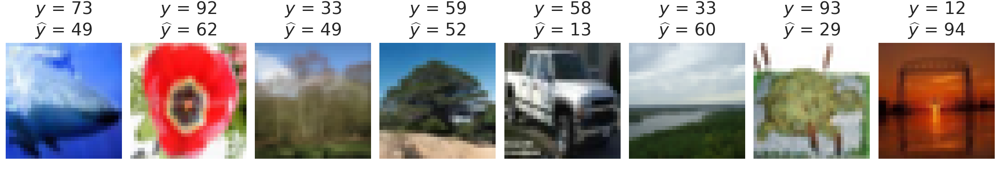

<IPython.core.display.Javascript object>


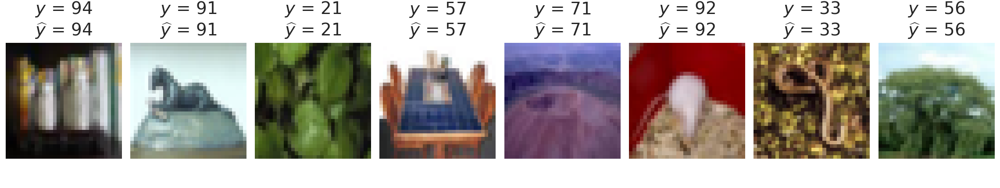

<IPython.core.display.Javascript object>


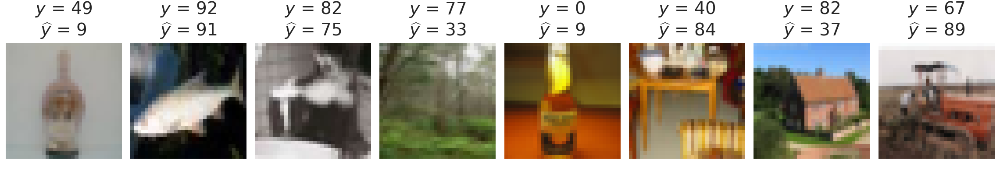

<IPython.core.display.Javascript object>


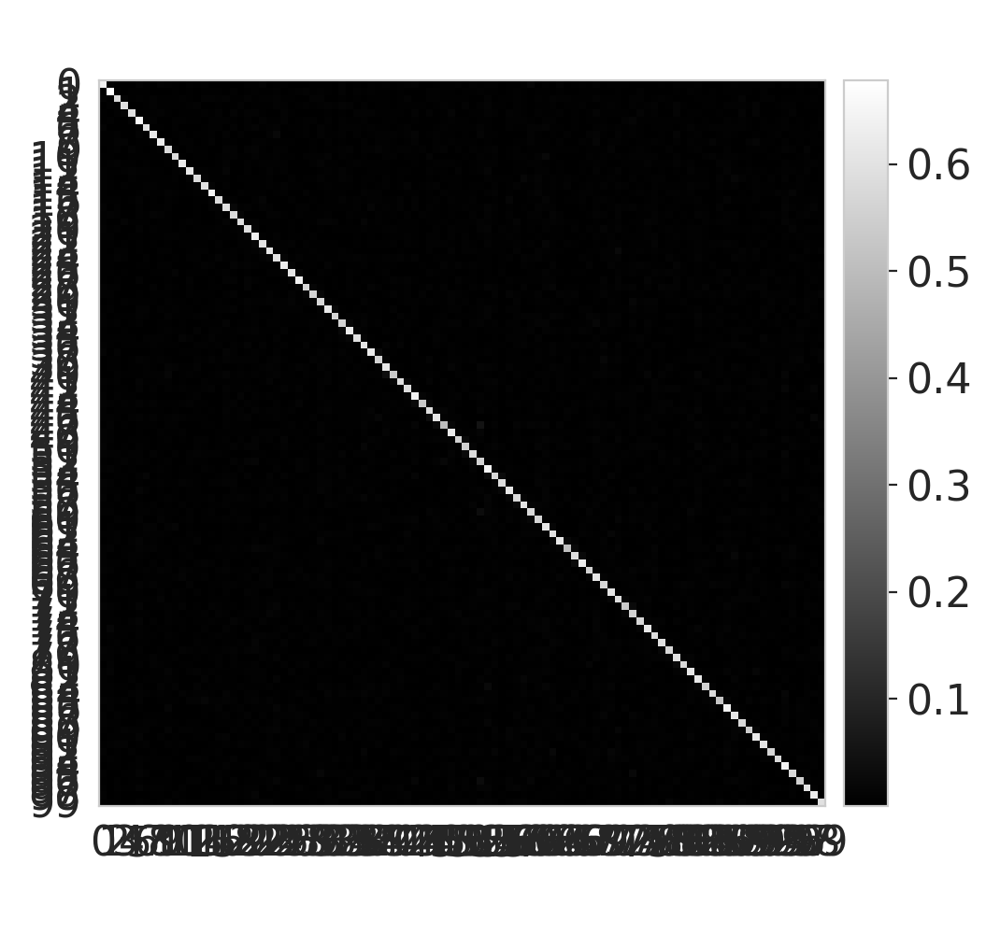

In [29]:
train_data, val_data, test_data, is_corrupted = data_utils.load_cifar_datasets(
    noise_level=0.4, n_classes=100, confusion_function=data_utils.uniform_error_confusion_matrix, seed=42)
model_file = 'aaron_logs/cifar100-error-noise0.4-PredictGradOutput-Laplace-L3.0-augment-loaded-seed42/checkpoints/best_val.mdl'
examine_model(model_file, train_data, val_data, test_data, is_corrupted, device='cuda:2',
              prefix='cifar100-error-noise40-', save=True)

### Clothing1M

In [115]:
label_names = ['T-Shirt', 'Shirt', 'Knitwear', 'Chiffon', 'Sweater', 'Hoodie', 'Windbreaker', 'Jacket', 'Downcoat', 'Suit', 'Shawl', 'Dress', 'Vest', 'Underwear']
train_data, val_data, test_data, _ = data_utils.load_clothing1M_datasets()
model_file = 'logs/clothing1M-PredictGradOutput-Gaussian-L10.0-double-resnet-augment-b32-loaded/checkpoints/best_val.mdl'
saved_data=examine_model(model_file, train_data, val_data, test_data, is_corrupted=None, device='cuda:2',
                         prefix='clothing1M-', label_names=label_names, save=True, num_workers=16, save_data=True,
                         image_cnt=16)

Loading the model from logs/clothing1M-PredictGradOutput-Gaussian-L10.0-double-resnet-augment-b32-loaded/checkpoints/best_val.mdl
output.shape: [None, 14]
output.shape: [None, 14]



  4%|▍         | 147/3907 [04:42<1:37:52,  1.56s/it]


  7%|▋         | 293/3907 [08:31<1:34:04,  1.56s/it]


 13%|█▎        | 511/3907 [14:11<1:28:44,  1.57s/it]


 17%|█▋        | 657/3907 [18:00<1:24:44,  1.56s/it]


 21%|██        | 803/3907 [21:49<1:21:40,  1.58s/it]


 24%|██▍       | 949/3907 [25:39<1:16:48,  1.56s/it]


 28%|██▊       | 1093/3907 [29:27<1:14:24,  1.59s/it]


 32%|███▏      | 1236/3907 [33:13<1:11:21,  1.60s/it]


 35%|███▌      | 1379/3907 [38:44<2:25:21,  3.45s/it]


 37%|███▋      | 1456/3907 [41:20<1:17:25,  1.90s/it]IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [ ]:
with open(os.path.join('plots', 'resources', 'clothing1M-most-confusing-samples.pkl'), 'wb') as f:
    pickle.dump(saved_data, f)
    
with open(os.path.join('plots', 'resources', 'clothing1M-most-confusing-samples.pkl'), 'rb') as f:
    saved_data = pickle.load(f)

/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


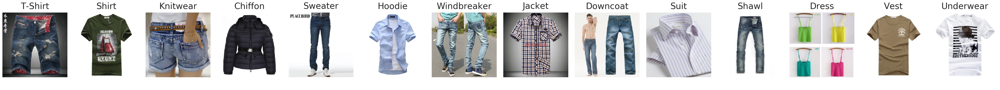

In [119]:
pad = 0.4
img_size = 1.25
fig, ax = plt.subplots(nrows=1, ncols=14, figsize=(13 * pad + 14 * img_size, img_size + 0.8))
for i in range(14):
    idx = saved_data[i]['class_sorted_indices'][-1]
    img = train_data[idx][0]
    img = data_utils.revert_normalization(img, train_data)[0]
    img = utils.to_numpy(img)
    img = get_image(img)
    
    import PIL
    from PIL import Image
    img = Image.fromarray(np.uint8(img*255))
    img = img.resize((224, 224))
#         img = img.resize((224, 224), resample=PIL.Image.BOX)
    ax[i].imshow(img)
    ax[i].set_axis_off()
    ax[i].set_xticklabels([])
    ax[i].set_yticklabels([])
    q_pred = saved_data[i]['top100_q_label_pred'][-1].argmax()
    ax[i].set_title("{}".format(label_names[train_data[idx][1]]),
                    fontsize=14)
# plt.subplots_adjust(wspace=0, hspace=0, left=0, right=1.0)
plt.tight_layout(pad=pad)
plt.savefig('plots/clothgin1M-most-confusing-one-per-class-new.pdf')

### MNIST noiseless


  0%|          | 0/188 [00:00<?, ?it/s]

Loading the model from hpc_logs/mnist-error-noise0.0-PredictGradOutput-Laplace-L0.1-seed42/checkpoints/best_val.mdl
[None, 1, 28, 28]
[None, 32, 14, 14]
[None, 32, 7, 7]
[None, 64, 3, 3]
[None, 256, 1, 1]
[None, 256]
[None, 128]
output.shape: [None, 10]
[None, 1, 28, 28]
[None, 32, 14, 14]
[None, 32, 7, 7]
[None, 64, 3, 3]
[None, 256, 1, 1]
[None, 256]
[None, 128]
output.shape: [None, 10]



100%|██████████| 188/188 [00:06<00:00, 27.50it/s]


<IPython.core.display.Javascript object>


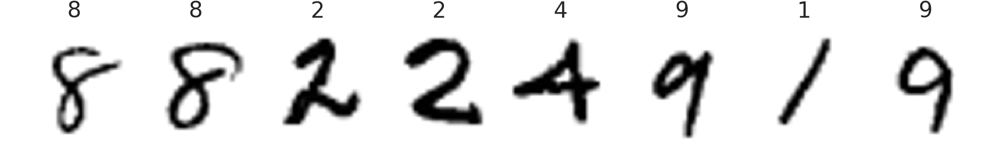

<IPython.core.display.Javascript object>


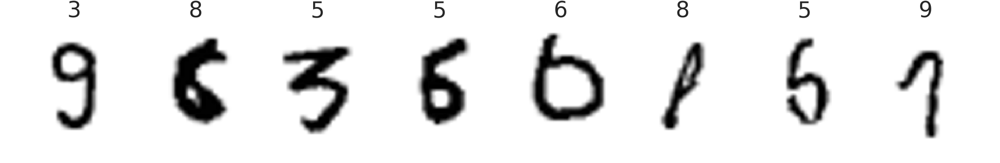

<IPython.core.display.Javascript object>


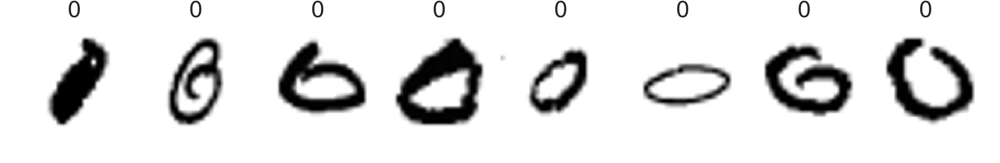

/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


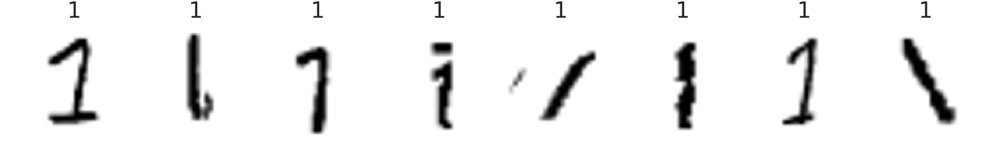

<IPython.core.display.Javascript object>


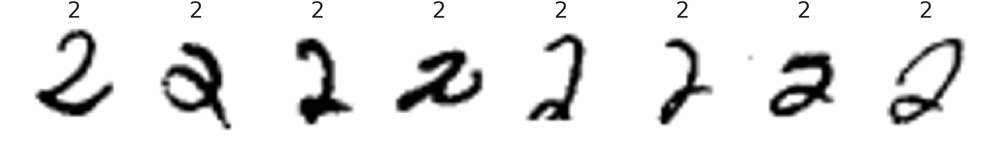

<IPython.core.display.Javascript object>


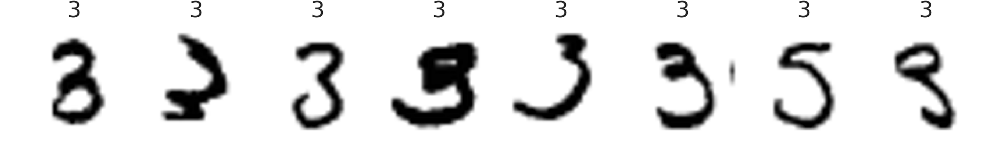

<IPython.core.display.Javascript object>


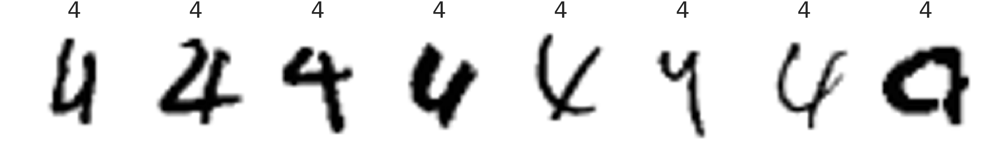

<IPython.core.display.Javascript object>


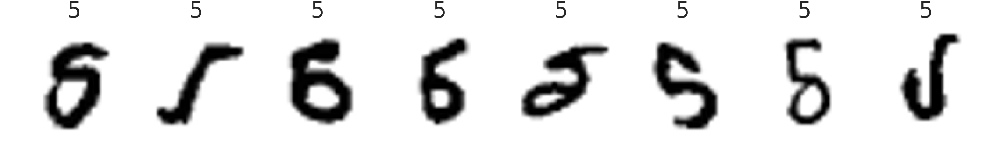

<IPython.core.display.Javascript object>


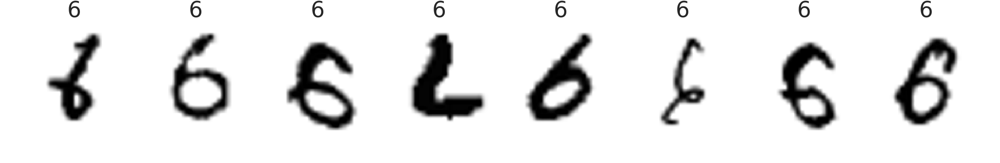

<IPython.core.display.Javascript object>


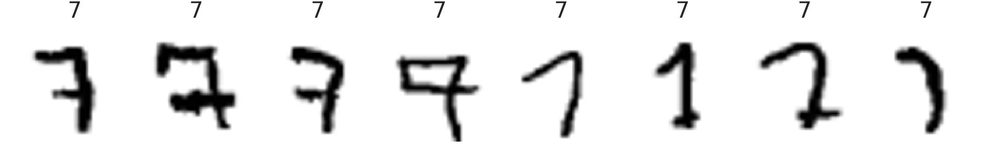

<IPython.core.display.Javascript object>


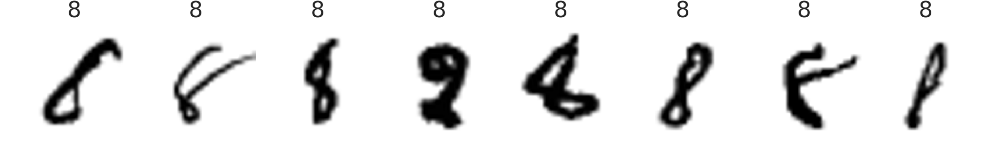

<IPython.core.display.Javascript object>


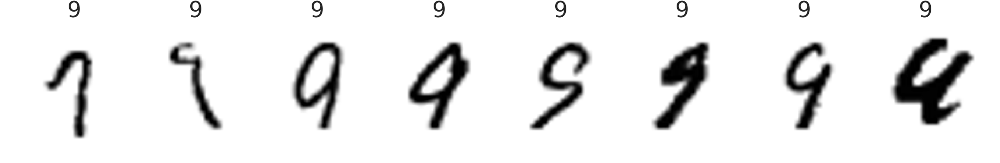

<IPython.core.display.Javascript object>


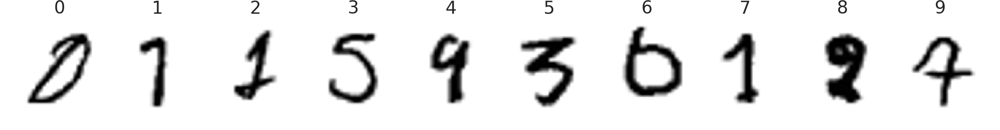

In [113]:
train_data, val_data, test_data, is_corrupted = data_utils.load_mnist_datasets(
    noise_level=0.0, confusion_function=data_utils.uniform_error_confusion_matrix, seed=42)
model_file = 'hpc_logs/mnist-error-noise0.0-PredictGradOutput-Laplace-L0.1-seed42/checkpoints/best_val.mdl'
examine_model(model_file, train_data, val_data, test_data, is_corrupted=None, device='cuda:2',
              prefix='mnist-error-noise0-', save=True, save_data=True);

### CIFAR-10 noiseless

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Loading the model from hpc_logs/cifar10-custom-noise0.0-PredictGradOutput-Gaussian-L0.3-augment-seed42/checkpoints/best_val.mdl
output.shape: [None, 10]
output.shape: [None, 10]



 99%|█████████▊| 155/157 [00:33<00:00,  4.57it/s]


100%|██████████| 157/157 [00:33<00:00,  4.65it/s]


<IPython.core.display.Javascript object>


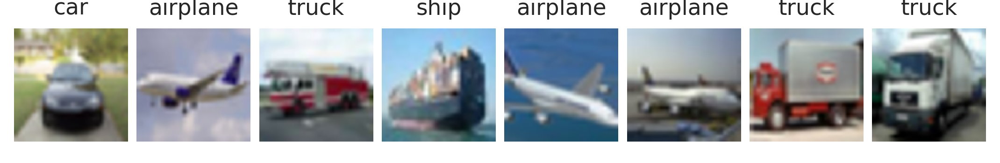

<IPython.core.display.Javascript object>


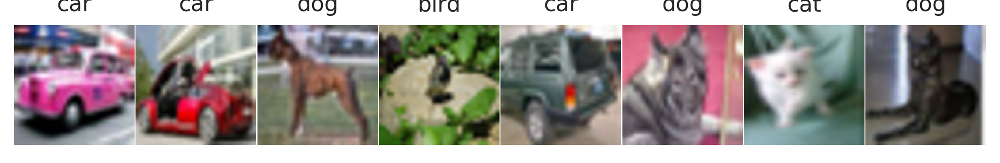

<IPython.core.display.Javascript object>


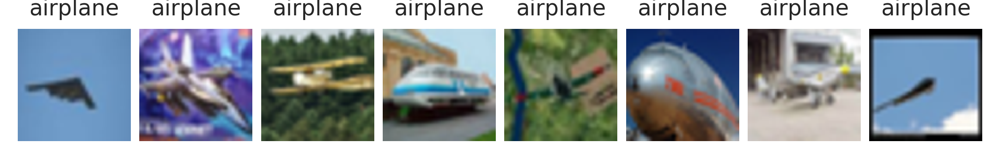

/nas/home/hrayrh/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


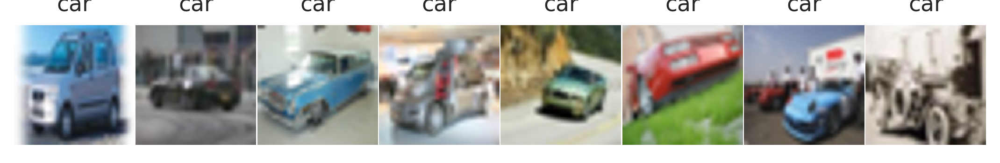

<IPython.core.display.Javascript object>


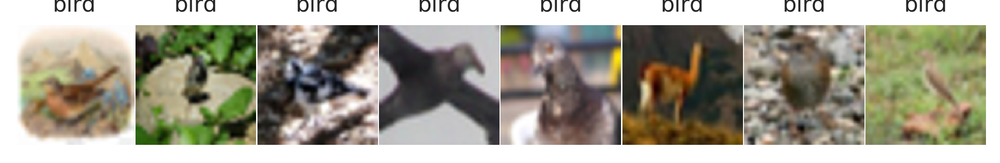

<IPython.core.display.Javascript object>


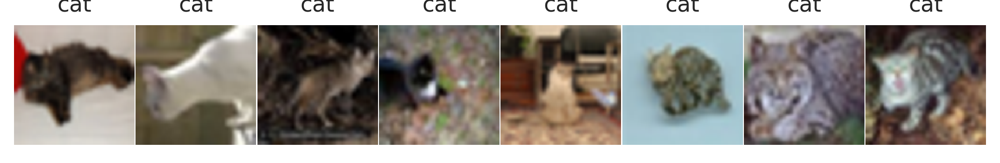

<IPython.core.display.Javascript object>


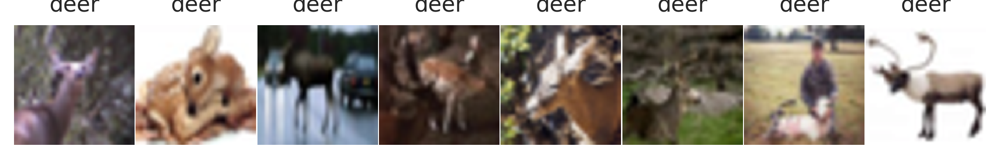

<IPython.core.display.Javascript object>


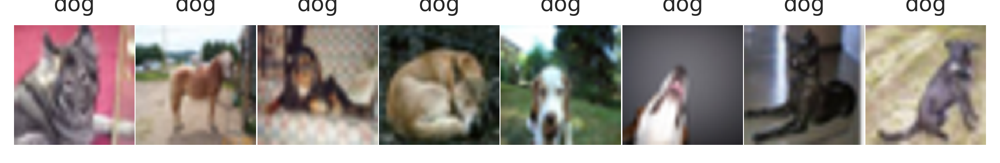

<IPython.core.display.Javascript object>


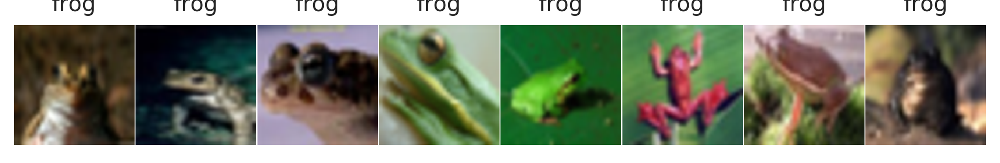

<IPython.core.display.Javascript object>


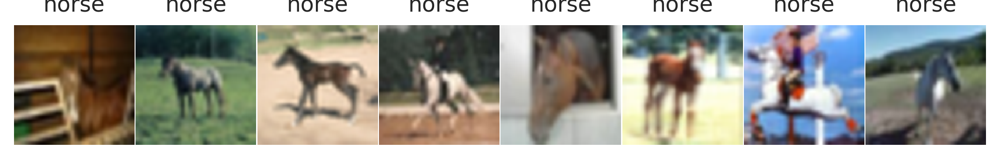

<IPython.core.display.Javascript object>


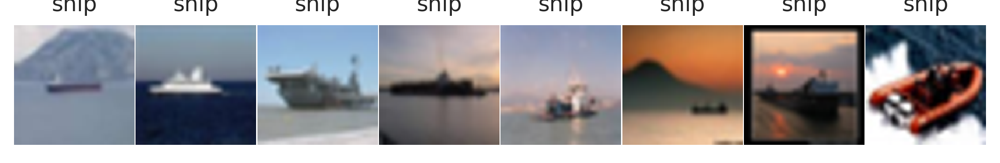

<IPython.core.display.Javascript object>


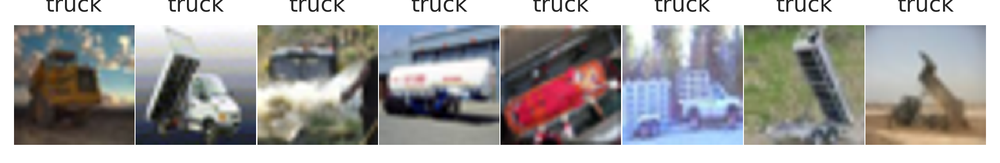

<IPython.core.display.Javascript object>


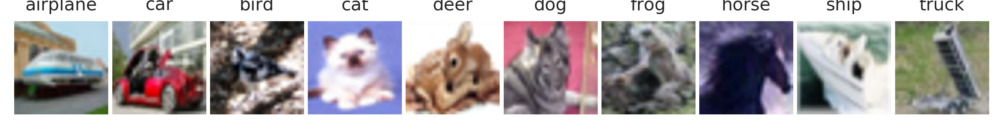

In [114]:
label_names = ['airplane', 'car', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']
train_data, val_data, test_data, is_corrupted = data_utils.load_cifar_datasets(
    noise_level=0.0, confusion_function=data_utils.uniform_error_confusion_matrix, seed=42)
# model_file = 'hpc_logs/cifar10-custom-noise0.0-PredictGradOutput-Laplace-L1.0-augment-seed42/checkpoints/best_val.mdl'
model_file = 'hpc_logs/cifar10-custom-noise0.0-PredictGradOutput-Gaussian-L0.3-augment-seed42/checkpoints/best_val.mdl'
examine_model(model_file, train_data, val_data, test_data, device='cuda:1', is_corrupted=None,
              prefix='cifar10-custom-noise0-', label_names=label_names, save=True);

# Prevent Overfitting experiment

In [8]:
# files = [
#     {
#         'name': 'proposed',
#         'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Laplace-L100.0-seed42',
#         'marker': 'o',
#         'markevery': 40
#     },
#     {
#         'name': 'no regularization',
#         'dir_path': 'mnist-error-noise0.8-StandardClassifier-seed42',
#         'marker': 'x',
#         'markevery': 40
#     },
#     {
#         'name': 'dropout 0.5',
#         'dir_path': 'mnist-error-noise0.8-StandardClassifier-dropout0.5-seed42',
#         'marker': '*',
#         'markevery': 40
#     },
#     {
#         'name': 'weight decay 0.003',
#         'dir_path': 'mnist-error-noise0.8-StandardClassifier-weight_decay0.003-seed42',
#         'marker': '^',
#         'markevery': 40
#     }
# ]

files = [
    {
        'name': 'proposed',
        'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Laplace-L50.0-seed42',
        'marker': 'o',
        'markevery': 60
    },
    {
        'name': 'no regularization',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-seed42',
        'marker': 'x',
        'markevery': 60
    },
    {
        'name': 'dropout 0.5',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-dropout0.5-seed42',
        'marker': '*',
        'markevery': 60
    },
    {
        'name': 'weight decay 0.003',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-weight_decay0.001-seed42',
        'marker': '^',
        'markevery': 60
    }
]

<IPython.core.display.Javascript object>


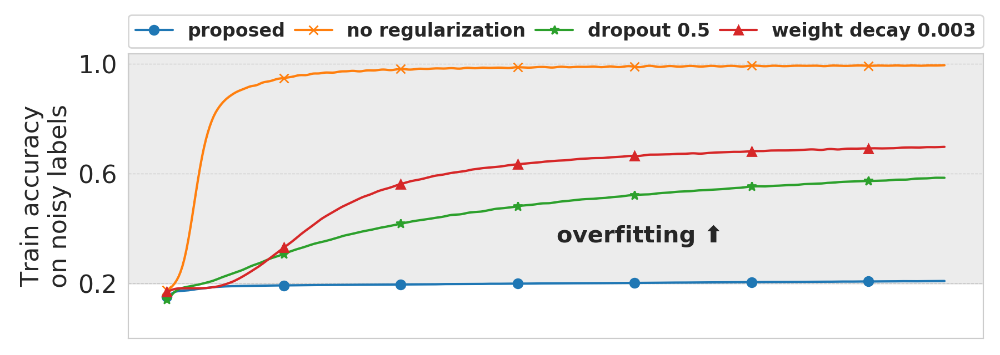

<IPython.core.display.Javascript object>


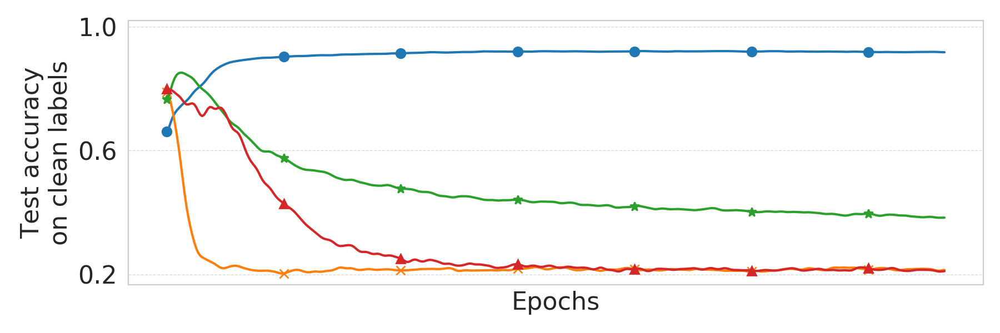

In [15]:
fig, ax = plot_from_tensorboard(plt, files, common_prefix='logs/prevent_overfitting_4layer/', tag='metrics/train_accuracy',
                      savename='plots/prevent_overfitting_4layer_train.pdf', smoothing=True, ymin=0.0, 
                      ylabel='Train accuracy\non noisy labels', figsize=(9,3.2), xticks=[],
                      yticks = [0.2, 0.6, 1.0], xlabel=None,
                      legend_args={
                         'bbox_to_anchor': (0.0, 1.02, 1, 0.04),
                         'loc': 'lower left',
                         'ncol': len(files),
                         'fontsize': 13,
                         'borderaxespad': 0,
                         'fancybox': True,
                         'mode': 'expand',
                         'prop': {'weight':'bold'}},
                      );
ax.axhspan(0.2, 1.05, alpha=0.15, color='gray')
ax.text(x=200, y=0.35, s=u'overfitting \u2B06', fontsize=15, fontweight='bold')
# ax.set_ylabel('Train accuracy\non noisy labels', fontsize=15, fontweight='bold')
# ax.set_yticks([0.2, 0.6, 1.0])
# ax.set_yticklabels([0.2, 0.6, 1.0], fontsize=14)
plt.savefig('plots/prevent_overfitting_4layer_train.pdf')

fig, ax = plot_from_tensorboard(plt, files, common_prefix='logs/prevent_overfitting_4layer/', tag='metrics/val_accuracy',
                      smoothing=True, savename='plots/prevent_overfitting_4layer_test.pdf', ylabel='Test accuracy\non clean labels',
                      yticks=[0.2, 0.6, 1.0], ymax=1.02,
                      figsize=(9,3), xticks=[]);
# ax.set_yticks([0.2, 0.6, 1.0])
# ax.set_yticklabels([0.2, 0.6, 1.0], fontsize=14)
# ax.set_ylabel('Test accuracy\non clean labels', fontsize=15, fontweight='bold')
# ax.set_xlabel('Epochs', fontsize=15, fontweight='bold')
plt.savefig('plots/prevent_overfitting_4layer_test.pdf')

# ICML video plots

In [39]:
files = [
    {
        'name': 'standard training',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-seed42',
        'marker': 'x',
        'markevery': 60
    },
    {
        'name': 'dropout 0.5',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-dropout0.5-seed42',
        'marker': '*',
        'markevery': 60
    },
    {
        'name': 'weight decay 0.003',
        'dir_path': 'mnist-error-noise0.8-StandardClassifier-weight_decay0.001-seed42',
        'marker': '^',
        'markevery': 60
    },
    {
        'name': 'proposed',
        'dir_path': 'mnist-error-noise0.8-PredictGradOutput-Laplace-L50.0-seed42',
        'marker': 'o',
        'markevery': 60
    },
]

<IPython.core.display.Javascript object>


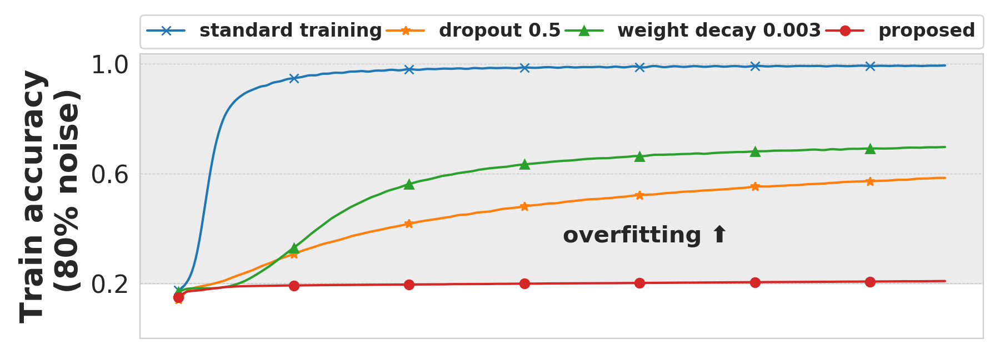

<IPython.core.display.Javascript object>


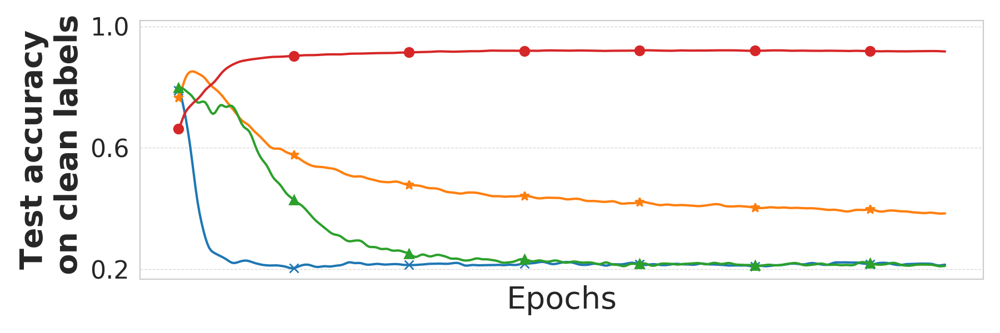

In [40]:
fig, ax = plot_from_tensorboard(plt, files, common_prefix='logs/prevent_overfitting_4layer/', tag='metrics/train_accuracy',
                      savename=None, smoothing=True, ymin=0.0, 
                      ylabel='Train accuracy\non noisy labels', figsize=(9,3.2), xticks=[],
                      yticks = [0.2, 0.6, 1.0], xlabel=None,
                      legend_args={
                         'bbox_to_anchor': (0.0, 1.02, 1, 0.04),
                         'loc': 'lower left',
                         'ncol': len(files),
                         'fontsize': 13,
                         'borderaxespad': 0,
                         'fancybox': True,
                         'mode': 'expand',
                         'prop': {'weight':'bold'}},
                      );
# ax.set_xlabel('Epochs', fontsize=20)
ax.set_ylabel('Train accuracy\n (80% noise)', fontsize=20, fontweight='bold')
ax.axhspan(0.2, 1.05, alpha=0.15, color='gray')
ax.text(x=200, y=0.35, s=u'overfitting \u2B06', fontsize=15, fontweight='bold')
# ax.set_ylabel('Train accuracy\non noisy labels', fontsize=15, fontweight='bold')
# ax.set_yticks([0.2, 0.6, 1.0])
# ax.set_yticklabels([0.2, 0.6, 1.0], fontsize=14)
fig.tight_layout()
plt.savefig('plots/prevent_overfitting_4layer_train-icml-video-3.pdf')

fig, ax = plot_from_tensorboard(plt, files, common_prefix='logs/prevent_overfitting_4layer/', tag='metrics/val_accuracy',
                      smoothing=True, savename=None, ylabel='Test accuracy\non clean labels',
                      yticks=[0.2, 0.6, 1.0], ymax=1.02,
                      figsize=(9,3), xticks=[]);
ax.set_xlabel('Epochs', fontsize=20)
ax.set_ylabel('Test accuracy\n on clean labels', fontsize=20, fontweight='bold')
# ax.set_yticks([0.2, 0.6, 1.0])
# ax.set_yticklabels([0.2, 0.6, 1.0], fontsize=14)
# ax.set_ylabel('Test accuracy\non clean labels', fontsize=15, fontweight='bold')
# ax.set_xlabel('Epochs', fontsize=15, fontweight='bold')
fig.tight_layout()
plt.savefig('plots/prevent_overfitting_4layer_test-icml-video-3.pdf')

# Junk

In [21]:
extract_results(df[df.data_augmentation == 1.0], dataset='cifar10', label_noise_type='cifar10_custom',
                noise_levels=[0.4], num_train_examples=['N/A'],
                bootstrap_std=False, print_stds=True, verbose=True)

cifar10-custom-noise0.4-StandardClassifier-augment-seed42
cifar10-custom-noise0.4-StandardClassifier-mae-augment-seed42
cifar10-custom-noise0.4-StandardClassifier-fw-augment-seed42
cifar10-custom-noise0.4-StandardClassifier-dmi-lr1e-06-augment-seed42
cifar10-custom-noise0.4-PredictGradOutput-Gaussian-L10.0-augment-seed42
cifar10-custom-noise0.4-PredictGradOutput-Laplace-L3.0-augment-seed42
cifar10-custom-noise0.4-PredictGradOutput-Gaussian-L10.0-augment-loaded-seed42
cifar10-custom-noise0.4-PredictGradOutput-Laplace-L10.0-augment-loaded-seed42
CE                             & 81.8 $\pm$  1.4\\
MAE                            & 61.1 $\pm$  3.9\\
FW                             & 84.6 $\pm$  3.9\\
DMI                            & 89.6 $\pm$  nan\\
Predict-Gaussian               & 86.0 $\pm$  nan\\
Predict-Laplace                & 84.2 $\pm$  nan\\
Predict-Gaussian-loaded        & 88.3 $\pm$  nan\\
Predict-Laplace-loaded         & 90.0 $\pm$  nan\\


In [ ]:
for num_train_examples in [1000, 10000, 'N/A']:
    part = df[(df.dataset == 'mnist') & (df.num_train_examples == num_train_examples)]
    if num_train_examples == 100:
        part = part.drop(part[part.label_noise_level == 0.99].index)

    test_acc_mean = part.pivot_table(values='test_accuracy_mean', index='label_noise_level',
                                     columns='method_name')
    test_acc_std = part.pivot_table(values='test_accuracy_std', index='label_noise_level',
                                     columns='method_name')
    

    noise_levels = sorted(list(set(part.label_noise_level)))
    fig, ax = plt.subplots(1)
    for method in test_acc_mean.columns:
        ax.errorbar(range(len(noise_levels)), 1.0-test_acc_mean[method], yerr=test_acc_std[method], label=method)
    ax.set(xticks=range(len(noise_levels)), xticklabels=noise_levels)
    ax.legend()

<IPython.core.display.Javascript object>


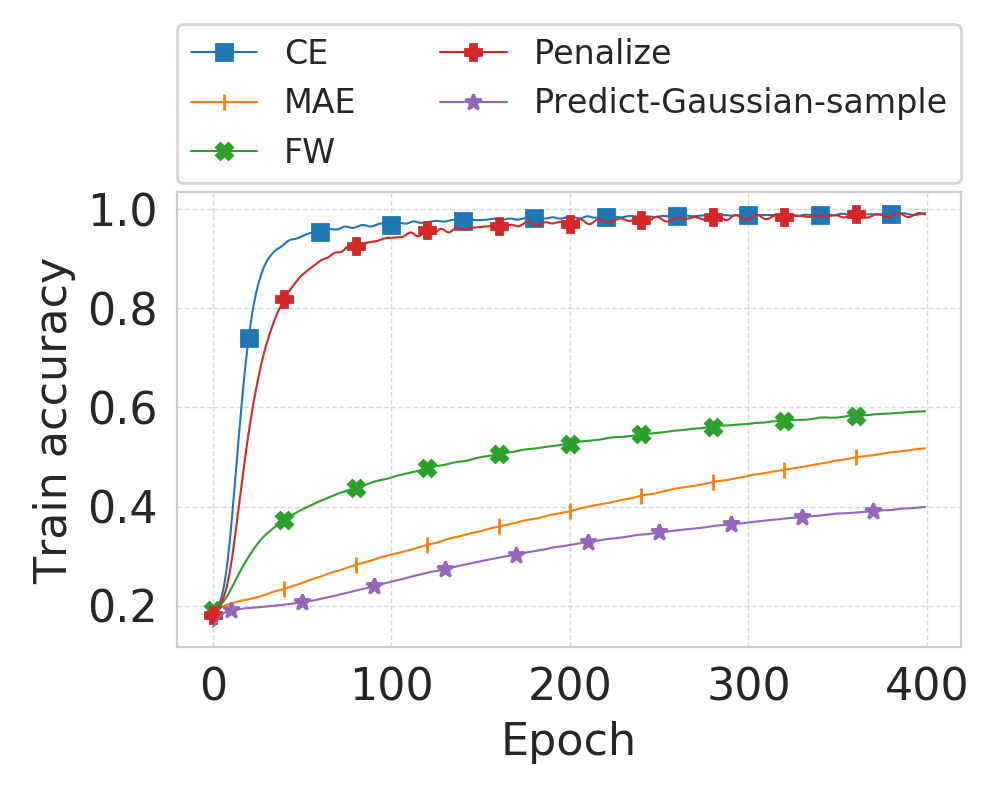

<IPython.core.display.Javascript object>


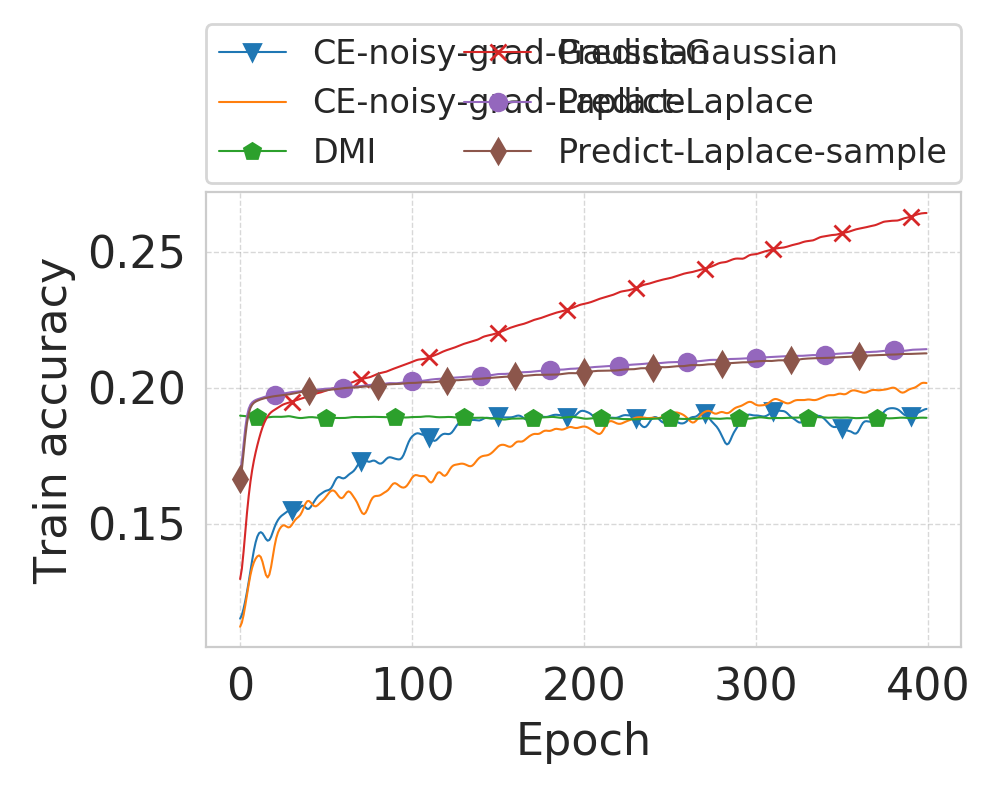

<IPython.core.display.Javascript object>


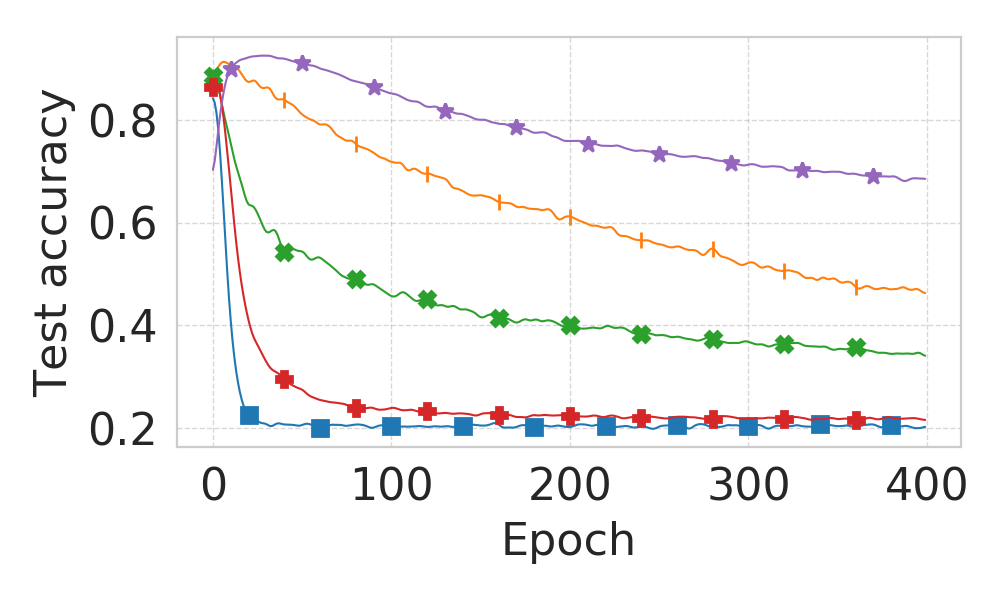

<IPython.core.display.Javascript object>


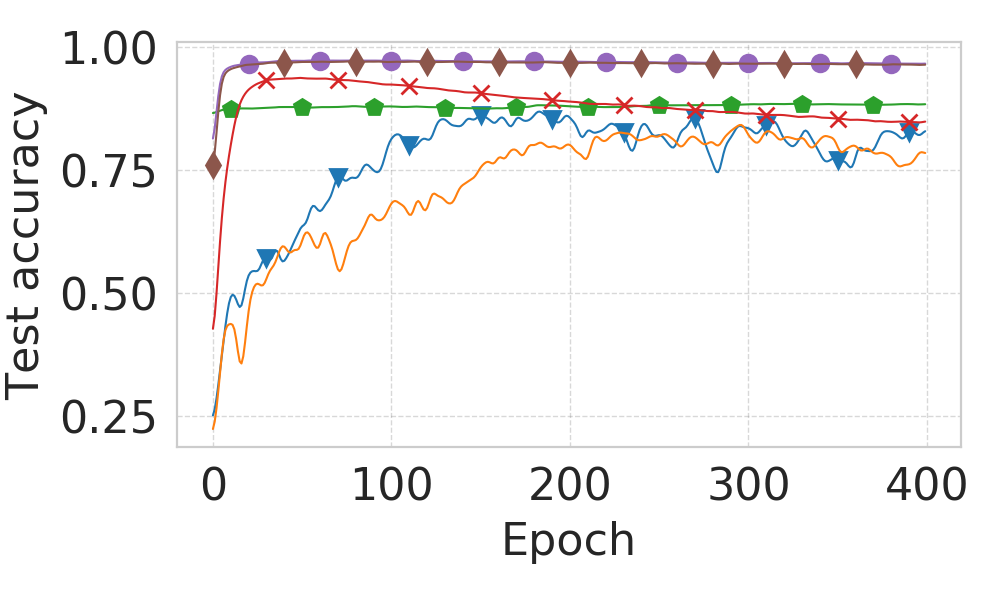

In [85]:
group1 = ['CE', 'Penalize', 'FW', 'MAE', 'Predict-Gaussian-sample']
group2 = [d['name'] for d in best_files if d['name'] not in group1]

group1_files = [d for d in best_files if d['name'] in group1]
group2_files = [d for d in best_files if d['name'] in group2]

plot_from_tensorboard(group1_files, common_prefix='clean_val_logs', tag='metrics/train_accuracy', smoothing=True,
                      ylabel='Train accuracy', figsize=(5,4), savename='plots/mnist-error-noise80-train-group1.pdf',
                      linewidth=0.75,
                      legend_args={
                         'bbox_to_anchor': (0.0, 1.02, 1, 0.04),
                         'loc': 'lower left',
                         'ncol': 2,
                         'borderaxespad': 0,
                         'fancybox': True,
                         'mode': 'expand'});

plot_from_tensorboard(group2_files, common_prefix='clean_val_logs', tag='metrics/train_accuracy', smoothing=True,
                      ylabel='Train accuracy', figsize=(5,4), savename='plots/mnist-error-noise80-train-group1.pdf',
                      linewidth=0.75,
                      legend_args={
                         'bbox_to_anchor': (0.0, 1.02, 1, 0.04),
                         'loc': 'lower left',
                         'ncol': 2,
                         'borderaxespad': 0,
                         'fancybox': True,
                         'mode': 'expand'});

plot_from_tensorboard(group1_files, common_prefix='clean_val_logs', tag='metrics/val_accuracy', smoothing=True,
                      ylabel='Test accuracy', figsize=(5,3), linewidth=0.75,
                      savename='plots/mnist-error-noise80-test-group1.pdf');


plot_from_tensorboard(group2_files, common_prefix='clean_val_logs', tag='metrics/val_accuracy', smoothing=True,
                      ylabel='Test accuracy', figsize=(5,3), linewidth=0.75,
                      savename='plots/mnist-error-noise80-test-group1.pdf');

In [31]:
bootstrap('logs/clothing1M-PredictGradOutput-Laplace-L3.0-double-resnet-augment-b32-loaded/test_predictions.pkl')

bootstrapping: 100%|██████████| 1000/1000 [00:00<00:00, 1333.29it/s]

70.53 0.44


{'mean': 0.7052598327949838, 'std': 0.0044119673139304694}